In [ ]:
#importing required files
import os
import cv2
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from skimage import io
from skimage.color import rgb2gray
from skimage.feature import hog
from scipy.io import loadmat
import pandas as pd
import seaborn as sns
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
from tqdm import tqdm as tqdm
import torchvision
import torch
import torch.nn.functional as F
from torchvision import transforms
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor
import math
import random
import scipy.io as io
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
from tensorflow.keras.layers import BatchNormalization, Dropout



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
x_path = "/content/drive/MyDrive/Semester5/dip/Dataset/DME Images/images"
y_path = "/content/drive/MyDrive/Semester5/dip/Dataset/DME Images/labels"

##Data Understanding

In [ ]:
x_files = sorted([file for file in os.listdir(x_path) if file.startswith("data_")])
y_files = sorted([file for file in os.listdir(y_path) if file.startswith("data_")])

assert len(x_files) == len(y_files), "Number of files in x and y directories must be the same."

file_pairs = list(zip(x_files, y_files))

random_seed = 42
random.shuffle(file_pairs)

file_pairs_train, file_pairs_temp = train_test_split(file_pairs, test_size=0.3, random_state=random_seed)


file_pairs_val, file_pairs_test = train_test_split(file_pairs_temp, test_size=0.5, random_state=random_seed)

for x_file, y_file in file_pairs_test:
    assert os.path.splitext(x_file)[0] == os.path.splitext(y_file)[0], f"Mismatch in file names: {x_file} and {y_file}"
for x_file, y_file in file_pairs_val:
    assert os.path.splitext(x_file)[0] == os.path.splitext(y_file)[0], f"Mismatch in file names: {x_file} and {y_file}"

print("Number of training pairs:", len(file_pairs_train))
print("Number of validation pairs:", len(file_pairs_val))
print("Number of testing pairs:", len(file_pairs_test))

Number of training pairs: 155
Number of validation pairs: 33
Number of testing pairs: 34


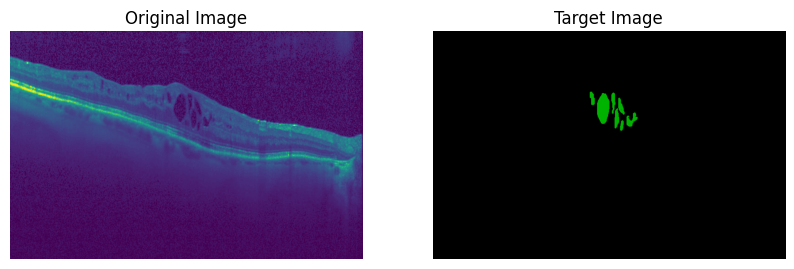

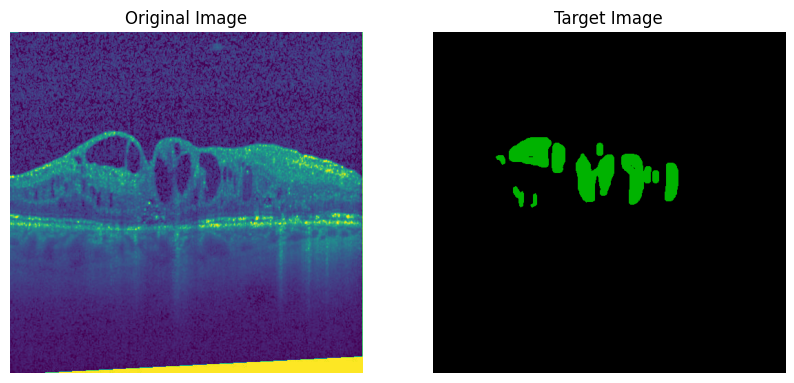

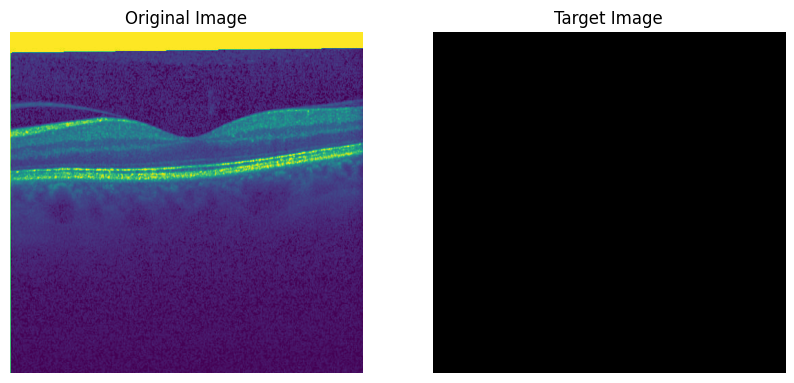

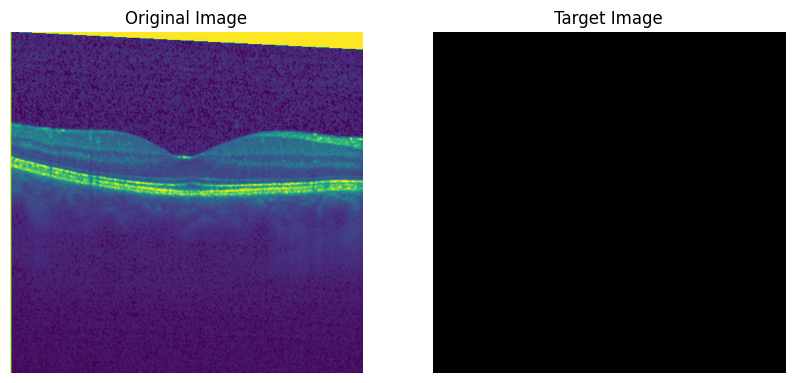

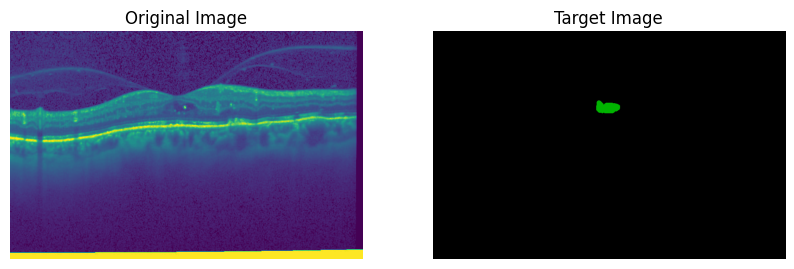

In [ ]:
def display_image_pairs(image_pairs, x_path, y_path, num_pairs=5):
    for i in range(num_pairs):
        x_file, y_file = image_pairs[i]
        x_img_path = os.path.join(x_path, x_file)
        y_img_path = os.path.join(y_path, y_file)

        x_img = mpimg.imread(x_img_path)
        y_img = mpimg.imread(y_img_path)

        fig, axarr = plt.subplots(1, 2, figsize=(10, 5))

        axarr[0].imshow(x_img)
        axarr[0].set_title(f'Original Image')
        axarr[0].axis('off')

        axarr[1].imshow(y_img)
        axarr[1].set_title(f'Target Image')
        axarr[1].axis('off')

        plt.show()

display_image_pairs(file_pairs_test[:5], x_path, y_path, num_pairs=5)


## Data Preprocessing

In [ ]:
def preprocess_image(image):

    blurred_image = cv2.GaussianBlur(image, (5, 5), 0)

    laplacian_image = cv2.Laplacian(blurred_image, cv2.CV_64F)
    sharpened_image = np.clip(image - 0.7 * laplacian_image, 0, 255).astype(np.uint8)
    return blurred_image, sharpened_image


In [ ]:
original_images = []
blurred_images = []
sharpened_images = []

for x_file, y_file in file_pairs_train:
    x_img_path = os.path.join(x_path, x_file)
    y_img_path = os.path.join(y_path, y_file)

    x_img = cv2.imread(x_img_path)
    y_img = cv2.imread(y_img_path)

    x_img = cv2.cvtColor(x_img, cv2.COLOR_BGR2RGB)
    y_img = cv2.cvtColor(y_img, cv2.COLOR_BGR2RGB)

    blurred, sharpened = preprocess_image(x_img)

    original_images.append(x_img)
    blurred_images.append(blurred)
    sharpened_images.append(sharpened)

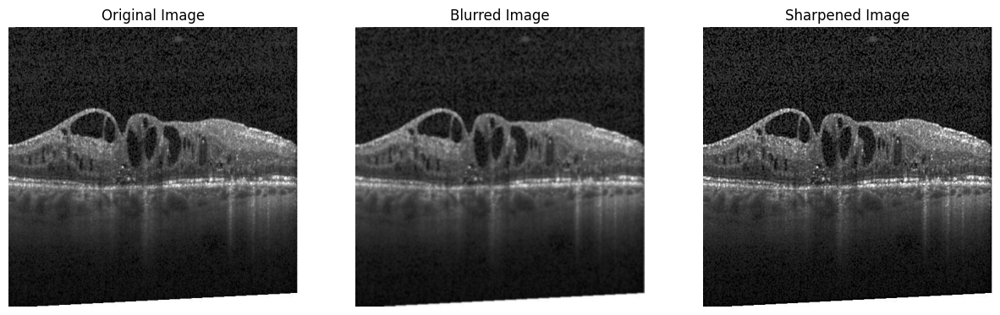

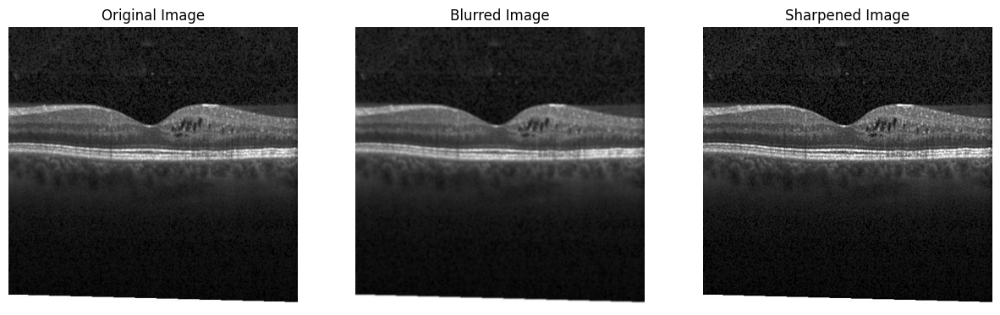

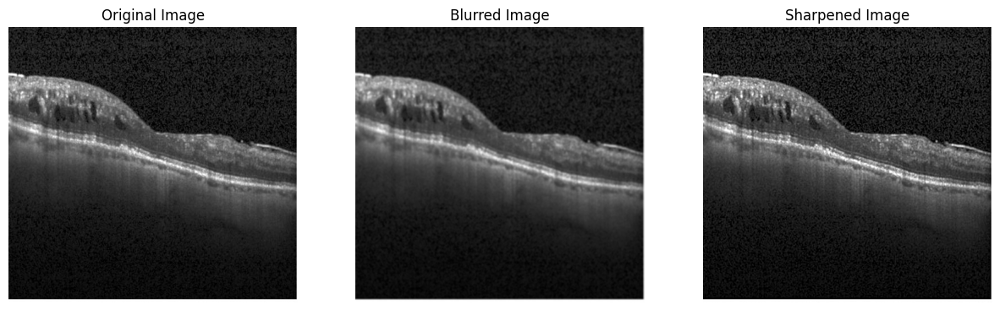

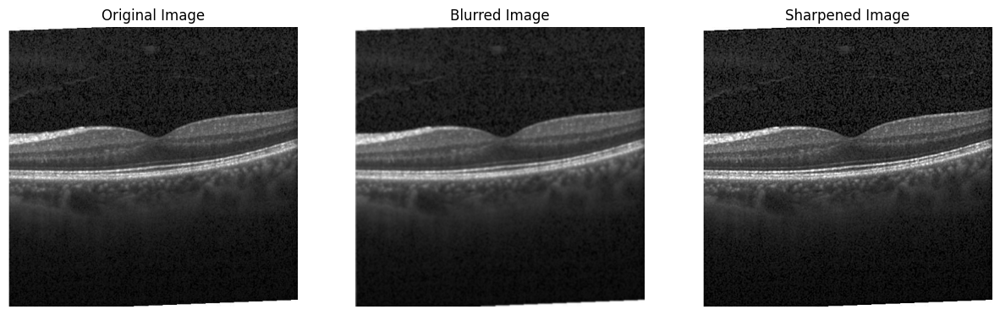

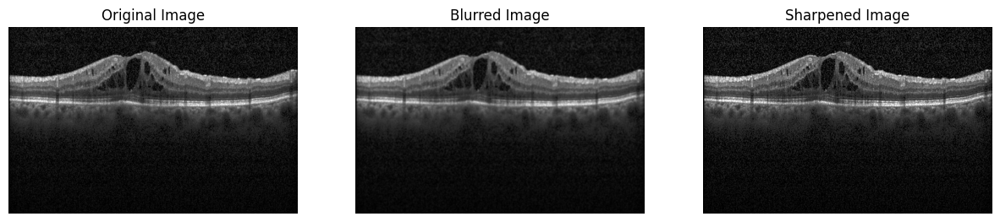

In [ ]:
num_pairs_to_display = 5

for i in range(num_pairs_to_display):
    original_img = original_images[i]
    blurred_img = blurred_images[i]
    sharpened_img = sharpened_images[i]

    # Plotting
    fig, axarr = plt.subplots(1, 3, figsize=(15, 5))

    axarr[0].imshow(original_img)
    axarr[0].set_title('Original Image')
    axarr[0].axis('off')

    axarr[1].imshow(blurred_img)
    axarr[1].set_title('Blurred Image')
    axarr[1].axis('off')

    axarr[2].imshow(sharpened_img)
    axarr[2].set_title('Sharpened Image')
    axarr[2].axis('off')

    plt.show()

In [ ]:
def preprocess_image(image):

    blurred_image = cv2.GaussianBlur(image, (5, 5), 0)

    laplacian_image = cv2.Laplacian(blurred_image, cv2.CV_64F)
    sharpened_image = np.clip(image - 0.7 * laplacian_image, 0, 255).astype(np.uint8)


    return image

## Segmentation

### Method 01 : FCNN

In [ ]:


def fcnn_model(input_shape):
    inputs = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, (3, 3), activation='relu', padding='same')(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    # Middle
    conv3 = Conv2D(256, (3, 3), activation='relu', padding='same')(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv3)

    # Decoder
    up1 = UpSampling2D(size=(2, 2))(conv3)
    concat1 = concatenate([conv2, up1], axis=-1)
    conv4 = Conv2D(128, (3, 3), activation='relu', padding='same')(concat1)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv4)

    up2 = UpSampling2D(size=(2, 2))(conv4)
    concat2 = concatenate([conv1, up2], axis=-1)
    conv5 = Conv2D(64, (3, 3), activation='relu', padding='same')(concat2)
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv5)

    # Output layer
    output = Conv2D(1, (1, 1), activation='sigmoid')(conv5)

    model = Model(inputs=inputs, outputs=output)

    return model

In [ ]:
img_shape = (256, 256, 1)

model = fcnn_model(img_shape)

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

x_train, y_train = load_data(file_pairs_train, x_path, y_path)
x_val,y_val = load_data(file_pairs_val, x_path, y_path)
x_test, y_test = load_data(file_pairs_test, x_path, y_path)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         640       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 64)         256       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['batch_normalization[0][0

In [ ]:
history = model.fit(x_train, y_train, epochs=350, batch_size=16, validation_data=(x_val, y_val))

Epoch 1/350
10/10 [==============================] - 6s 618ms/step - loss: -19.0013 - accuracy: 0.9496 - val_loss: -9.4790 - val_accuracy: 0.9821
Epoch 2/350
10/10 [==============================] - 7s 684ms/step - loss: -19.0587 - accuracy: 0.9577 - val_loss: -13.2913 - val_accuracy: 0.9788
Epoch 3/350
10/10 [==============================] - 7s 701ms/step - loss: -19.0822 - accuracy: 0.9508 - val_loss: -12.7984 - val_accuracy: 0.9774
Epoch 4/350
10/10 [==============================] - 6s 650ms/step - loss: -19.1669 - accuracy: 0.9591 - val_loss: -12.4754 - val_accuracy: 0.9797
Epoch 5/350
10/10 [==============================] - 6s 635ms/step - loss: -19.1450 - accuracy: 0.9575 - val_loss: -12.5849 - val_accuracy: 0.9803
Epoch 6/350
10/10 [==============================] - 6s 625ms/step - loss: -19.1004 - accuracy: 0.9596 - val_loss: -12.5111 - val_accuracy: 0.9711
Epoch 7/350
10/10 [==============================] - 7s 683ms/step - loss: -18.9305 - accuracy: 0.9440 - val_loss: -18.

In [ ]:
history_dict = history.history
train_accuracy = history_dict['accuracy']
train_loss = history_dict['loss']
val_accuracy = history_dict['val_accuracy']
val_loss = history_dict['val_loss']

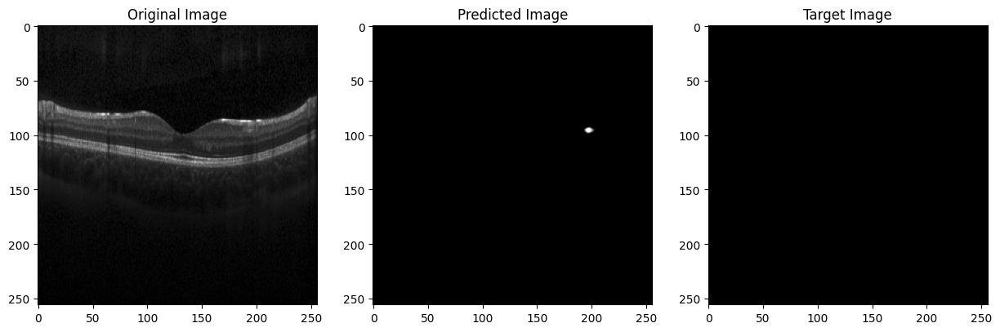

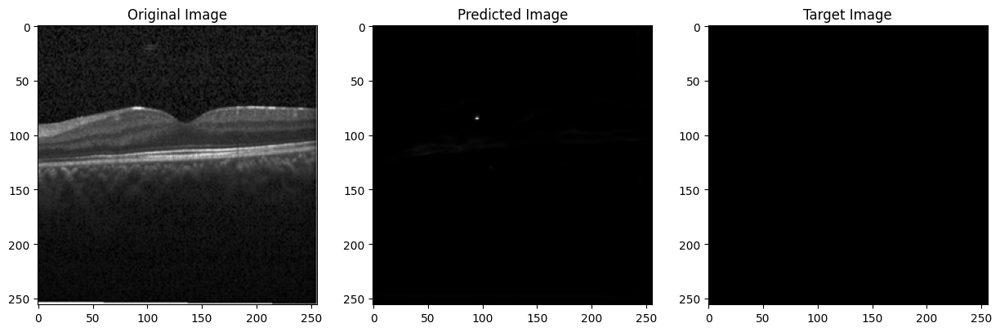

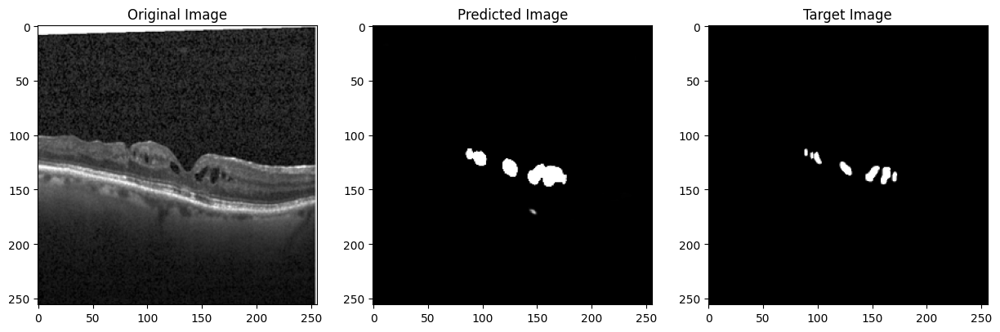

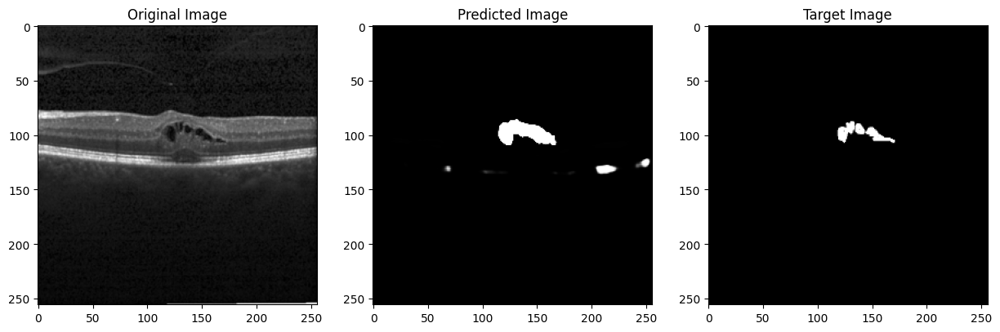

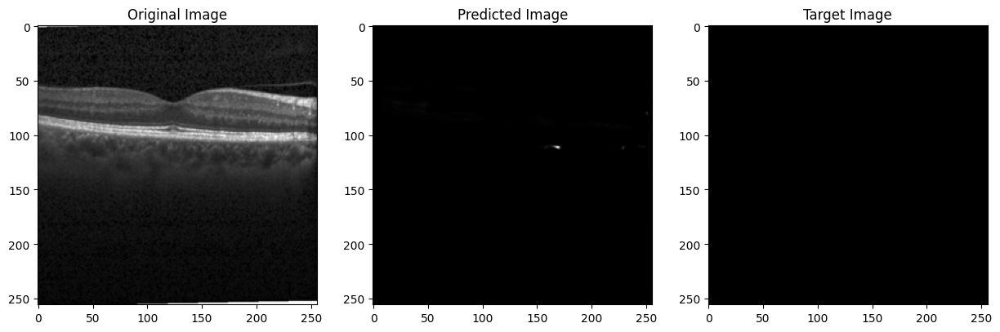

...

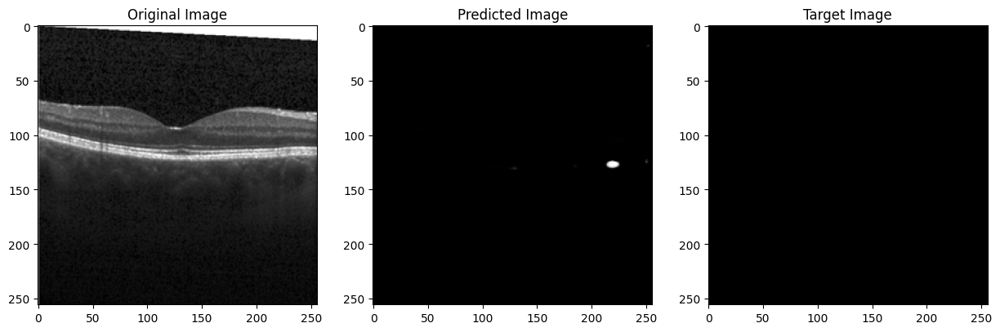

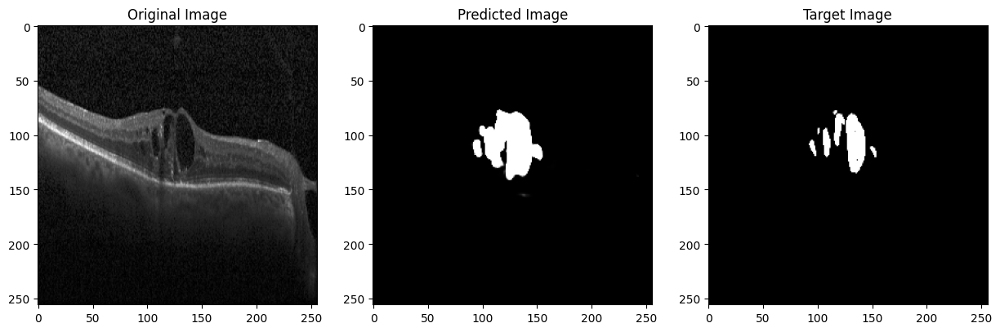

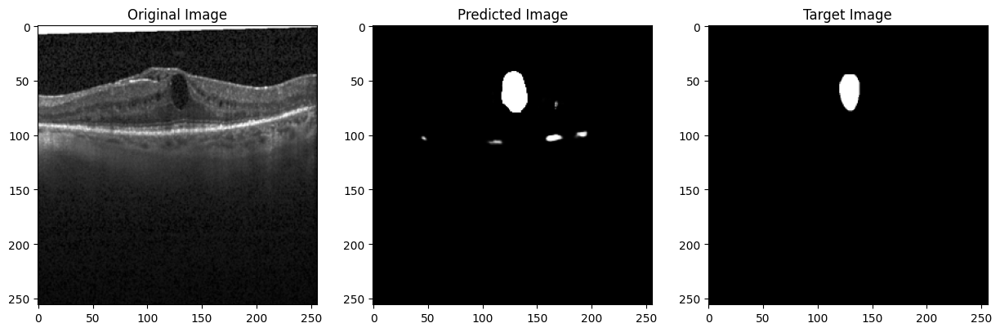

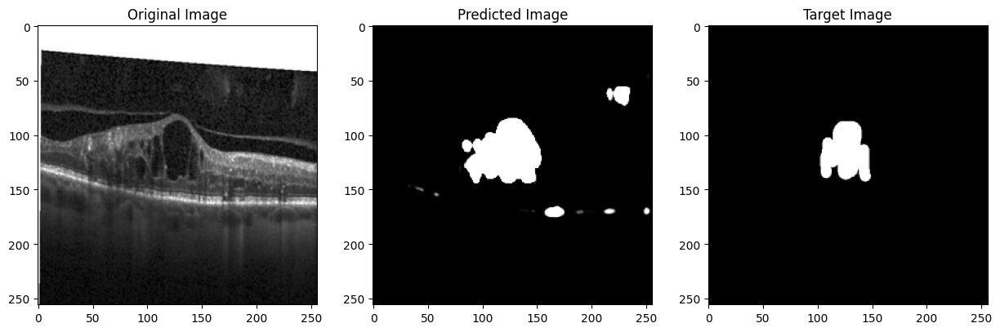

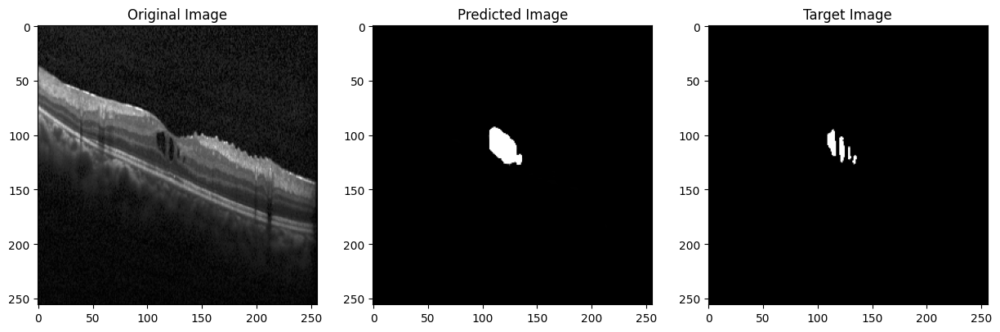

In [ ]:
num_samples = len(x_test)

for i in range(num_samples):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(x_test[i].squeeze(), cmap='gray')
    plt.title('Original Image')

    plt.subplot(1, 3, 2)
    plt.imshow(y_pred[i].squeeze(), cmap='gray')
    plt.title('Predicted Image')

    plt.subplot(1, 3, 3)
    plt.imshow(y_test[i], cmap='gray')
    plt.title('Target Image')

    plt.show()

### Model 02: SegNet

In [ ]:
def segnet_model(input_shape):
    inputs = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3 = BatchNormalization()(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(512, 3, activation='relu', padding='same')(pool3)
    conv4 = BatchNormalization()(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    # Decoder
    up5 = UpSampling2D(size=(2, 2))(pool4)
    upconv5 = Conv2D(512, 3, activation='relu', padding='same')(up5)
    upconv5 = BatchNormalization()(upconv5)
    merge5 = Concatenate()([conv4, upconv5])

    up6 = UpSampling2D(size=(2, 2))(merge5)
    upconv6 = Conv2D(256, 3, activation='relu', padding='same')(up6)
    upconv6 = BatchNormalization()(upconv6)
    merge6 = Concatenate()([conv3, upconv6])

    up7 = UpSampling2D(size=(2, 2))(merge6)
    upconv7 = Conv2D(128, 3, activation='relu', padding='same')(up7)
    upconv7 = BatchNormalization()(upconv7)
    merge7 = Concatenate()([conv2, upconv7])

    up8 = UpSampling2D(size=(2, 2))(merge7)
    upconv8 = Conv2D(64, 3, activation='relu', padding='same')(up8)
    upconv8 = BatchNormalization()(upconv8)
    merge8 = Concatenate()([conv1, upconv8])

    # Output
    outputs = Conv2D(1, 1, activation='sigmoid', padding='same')(merge8)

    model = Model(inputs=inputs, outputs=outputs)
    return model

In [ ]:
img_shape = (256, 256, 1)

model = segnet_model(img_shape)

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         640       ['input_2[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 64)         256       ['conv2d_1[0][0]']            
 Normalization)                                                                                   
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['batch_normalization[0][0

In [ ]:
x_train, y_train = load_data(file_pairs_train, x_path, y_path)
x_val,y_val = load_data(file_pairs_val, x_path, y_path)
x_test, y_test = load_data(file_pairs_test, x_path, y_path)

In [ ]:
history = model.fit(x_train, y_train, epochs=350, batch_size=16, validation_data=(x_val, y_val))

Epoch 1/350
10/10 [==============================] - 6s 618ms/step - loss: -19.0013 - accuracy: 0.9496 - val_loss: -9.4790 - val_accuracy: 0.9821
Epoch 2/350
10/10 [==============================] - 7s 684ms/step - loss: -19.0587 - accuracy: 0.9577 - val_loss: -13.2913 - val_accuracy: 0.9788
Epoch 3/350
10/10 [==============================] - 7s 701ms/step - loss: -19.0822 - accuracy: 0.9508 - val_loss: -12.7984 - val_accuracy: 0.9774
Epoch 4/350
10/10 [==============================] - 6s 650ms/step - loss: -19.1669 - accuracy: 0.9591 - val_loss: -12.4754 - val_accuracy: 0.9797
Epoch 5/350
10/10 [==============================] - 6s 635ms/step - loss: -19.1450 - accuracy: 0.9575 - val_loss: -12.5849 - val_accuracy: 0.9803
Epoch 6/350
10/10 [==============================] - 6s 625ms/step - loss: -19.1004 - accuracy: 0.9596 - val_loss: -12.5111 - val_accuracy: 0.9711
Epoch 7/350
10/10 [==============================] - 7s 683ms/step - loss: -18.9305 - accuracy: 0.9440 - val_loss: -18.

In [ ]:
history_dict = history.history
train_accuracy = history_dict['accuracy']
train_loss = history_dict['loss']
val_accuracy = history_dict['val_accuracy']
val_loss = history_dict['val_loss']

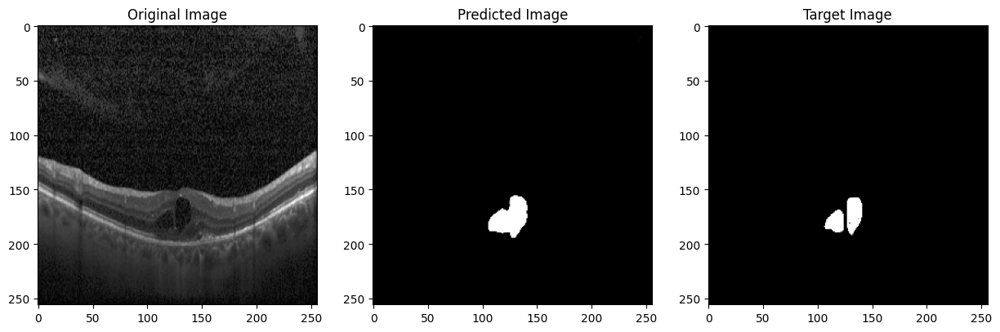

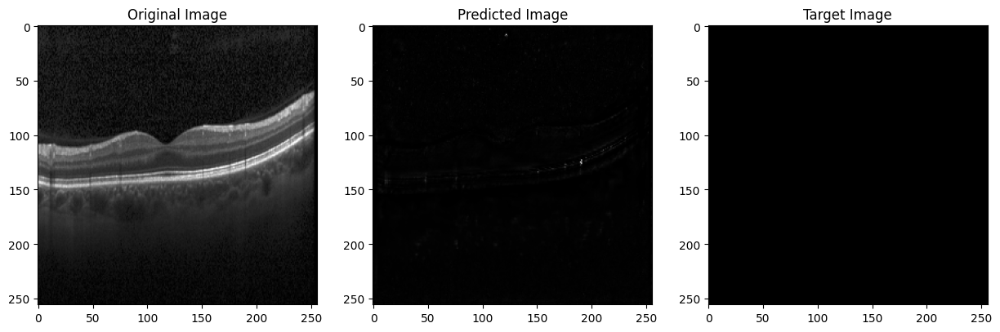

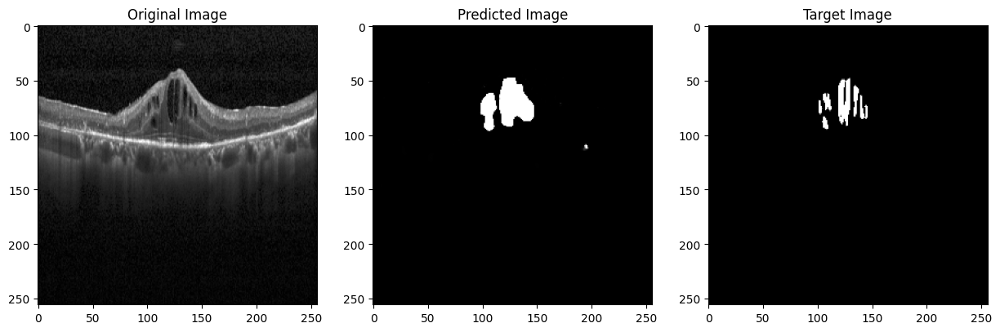

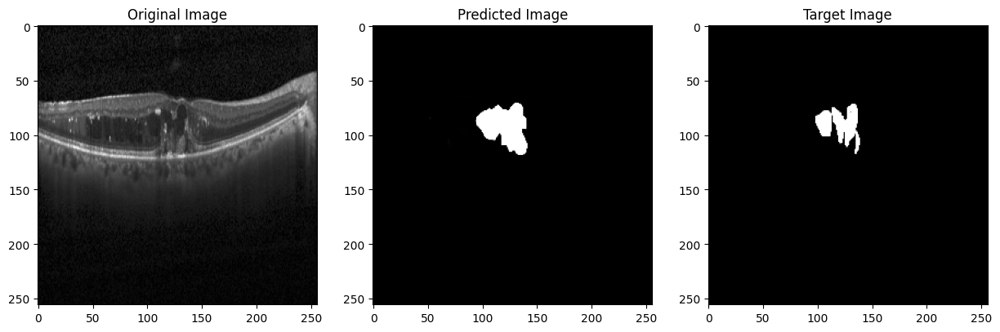

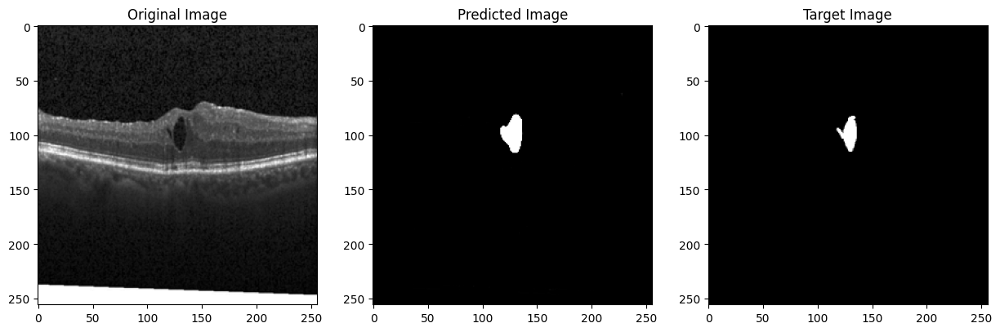

...

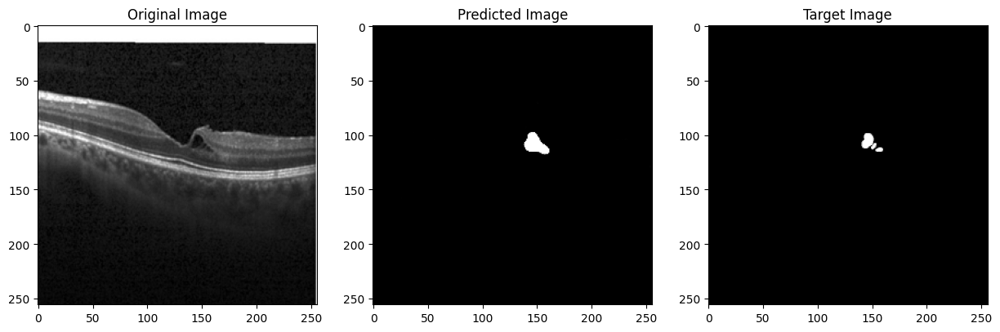

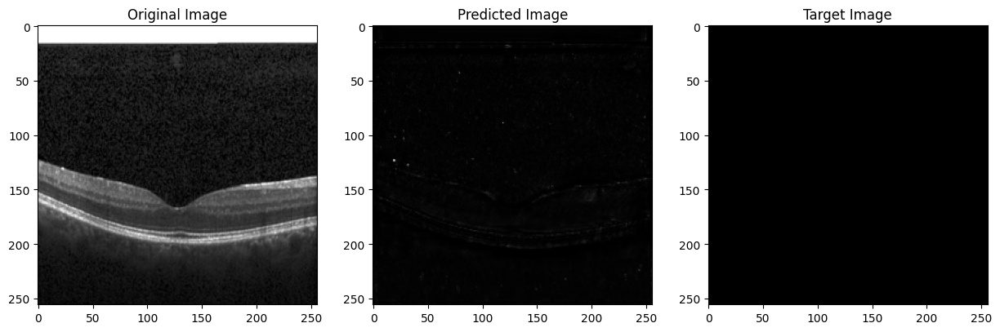

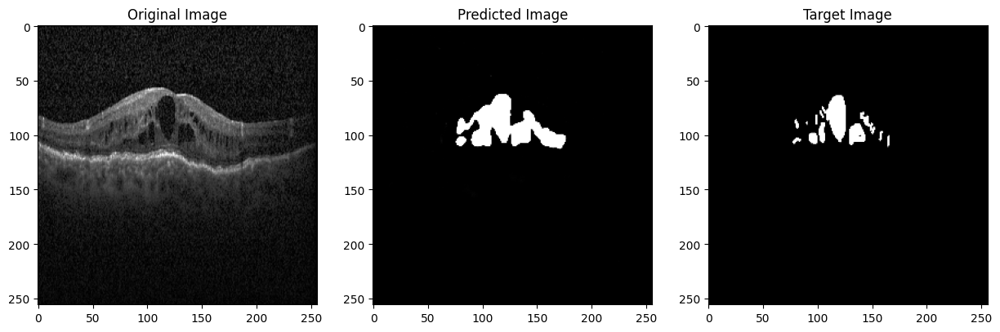

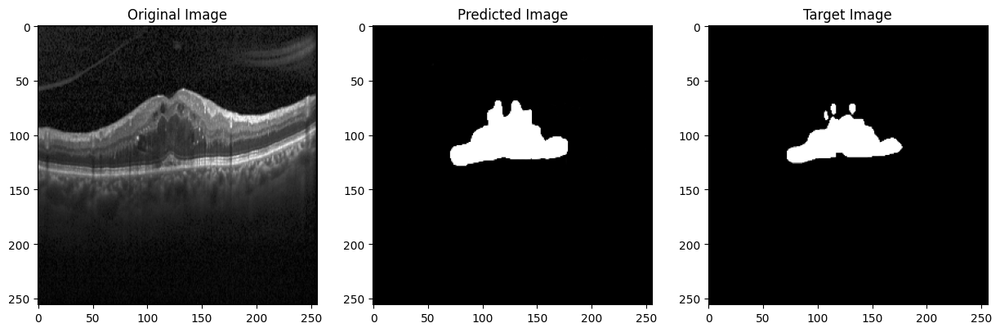

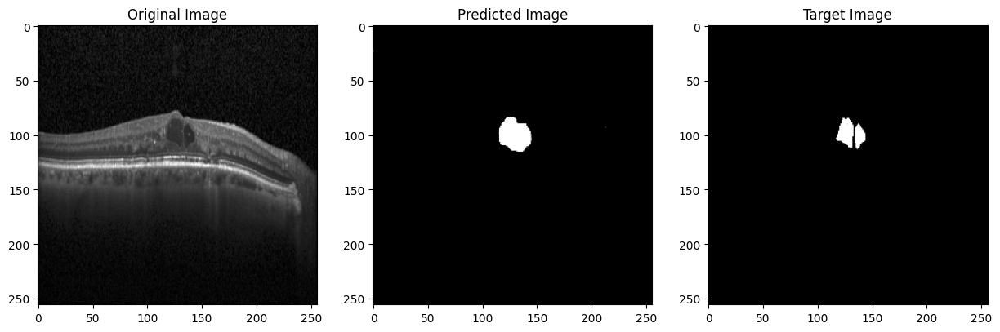

In [ ]:
num_samples = len(x_test)

for i in range(num_samples):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(x_test[i].squeeze(), cmap='gray')
    plt.title('Original Image')

    plt.subplot(1, 3, 2)
    plt.imshow(y_pred[i].squeeze(), cmap='gray')
    plt.title('Predicted Image')

    plt.subplot(1, 3, 3)
    plt.imshow(y_test[i], cmap='gray')
    plt.title('Target Image')

    plt.show()

### Method 03 : U-NET

In [ ]:
def unet_model(input_size=(new_height, new_width, 1)):
    inputs = tf.keras.Input(shape=input_size)

    # Encoder
    conv1 = layers.Conv2D(64, 3, padding='same')(inputs)
    conv1 = layers.LeakyReLU(alpha=0.2)(conv1)
    conv1 = layers.BatchNormalization()(conv1)
    conv1 = layers.Conv2D(64, 3, padding='same')(conv1)
    conv1 = layers.LeakyReLU(alpha=0.2)(conv1)
    conv1 = layers.BatchNormalization()(conv1)
    pool1 = layers.MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = layers.Conv2D(128, 3, padding='same')(pool1)
    conv2 = layers.LeakyReLU(alpha=0.2)(conv2)
    conv2 = layers.BatchNormalization()(conv2)
    conv2 = layers.Conv2D(128, 3, padding='same')(conv2)
    conv2 = layers.LeakyReLU(alpha=0.2)(conv2)
    conv2 = layers.BatchNormalization()(conv2)
    pool2 = layers.MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = layers.Conv2D(256, 3, padding='same')(pool2)
    conv3 = layers.LeakyReLU(alpha=0.2)(conv3)
    conv3 = layers.BatchNormalization()(conv3)
    conv3 = layers.Conv2D(256, 3, padding='same')(conv3)
    conv3 = layers.LeakyReLU(alpha=0.2)(conv3)
    conv3 = layers.BatchNormalization()(conv3)
    pool3 = layers.MaxPooling2D(pool_size=(2, 2))(conv3)


    # Decoder
    up4 = layers.UpSampling2D(size=(2, 2))(conv3)
    up4 = layers.concatenate([up4, conv2], axis=-1)
    conv4 = layers.Conv2D(128, 3, padding='same')(up4)
    conv4 = layers.LeakyReLU(alpha=0.2)(conv4)
    conv4 = layers.BatchNormalization()(conv4)
    conv4 = layers.Conv2D(128, 3, padding='same')(conv4)
    conv4 = layers.LeakyReLU(alpha=0.2)(conv4)
    conv4 = layers.BatchNormalization()(conv4)

    up5 = layers.UpSampling2D(size=(2, 2))(conv4)
    up5 = layers.concatenate([up5, conv1], axis=-1)
    conv5 = layers.Conv2D(64, 3, padding='same')(up5)
    conv5 = layers.LeakyReLU(alpha=0.2)(conv5)
    conv5 = layers.BatchNormalization()(conv5)
    conv5 = layers.Conv2D(64, 3, padding='same')(conv5)
    conv5 = layers.LeakyReLU(alpha=0.2)(conv5)
    conv5 = layers.BatchNormalization()(conv5)


    outputs = layers.Conv2D(1, 1, activation='sigmoid')(conv5)

    model = models.Model(inputs=inputs, outputs=outputs)

    return model

In [ ]:
img_shape = (256, 256, 1)

model = unet_model(img_shape)

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

def load_data(file_pairs, x_path, y_path):
    x_data = []
    y_data = []
    for x_file, y_file in file_pairs:
        x_path_file = os.path.join(x_path, x_file)
        y_path_file = os.path.join(y_path, y_file)


        x_img = cv2.resize(x_img, (img_shape[0], img_shape[1]))
        y_img = cv2.resize(y_img, (img_shape[0], img_shape[1]))

        x_img = cv2.cvtColor(x_img, cv2.COLOR_BGR2GRAY)

        x_img = np.expand_dims(x_img, axis=-1)

        x_data.append(x_img)
        y_data.append(y_img)

    return np.array(x_data), np.array(y_data)

x_train, y_train = load_data(file_pairs_train, x_path, y_path)
x_val,y_val = load_data(file_pairs_val, x_path, y_path)
x_test, y_test = load_data(file_pairs_test, x_path, y_path)

In [ ]:
loaded_model.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 284, 284, 1)]        0         []                            
                                                                                                  
 conv2d_55 (Conv2D)          (None, 284, 284, 64)         640       ['input_6[0][0]']             
                                                                                                  
 leaky_re_lu_50 (LeakyReLU)  (None, 284, 284, 64)         0         ['conv2d_55[0][0]']           
                                                                                                  
 batch_normalization_50 (Ba  (None, 284, 284, 64)         256       ['leaky_re_lu_50[0][0]']      
 tchNormalization)                                                                          

In [ ]:
history = model.fit(x_train, y_train, epochs=350, batch_size=16, validation_data=(x_val, y_val))

Epoch 1/350
8/8 [==============================] - 6s 762ms/step - loss: -20.4987 - accuracy: 0.9796 - val_loss: -16.9998 - val_accuracy: 0.9829
Epoch 2/350
8/8 [==============================] - 6s 768ms/step - loss: -20.5002 - accuracy: 0.9796 - val_loss: -17.0245 - val_accuracy: 0.9829
Epoch 3/350
8/8 [==============================] - 6s 718ms/step - loss: -20.5024 - accuracy: 0.9793 - val_loss: -17.2543 - val_accuracy: 0.9826
Epoch 4/350
8/8 [==============================] - 6s 772ms/step - loss: -20.4971 - accuracy: 0.9799 - val_loss: -17.4132 - val_accuracy: 0.9824
Epoch 5/350
8/8 [==============================] - 6s 720ms/step - loss: -20.5057 - accuracy: 0.9797 - val_loss: -17.2816 - val_accuracy: 0.9826
Epoch 6/350
8/8 [==============================] - 6s 723ms/step - loss: -20.4968 - accuracy: 0.9800 - val_loss: -17.6235 - val_accuracy: 0.9820
Epoch 7/350
8/8 [==============================] - 6s 773ms/step - loss: -20.5035 - accuracy: 0.9794 - val_loss: -17.6607 - val_ac

In [ ]:
history_dict = history.history
train_accuracy = history_dict['accuracy']
train_loss = history_dict['loss']
val_accuracy = history_dict['val_accuracy']
val_loss = history_dict['val_loss']

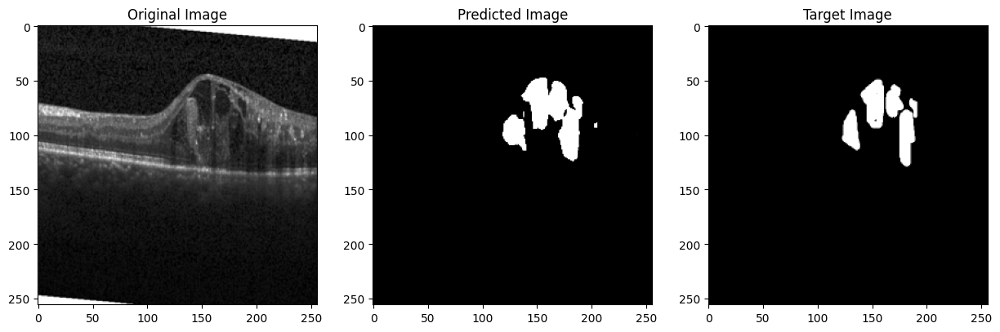

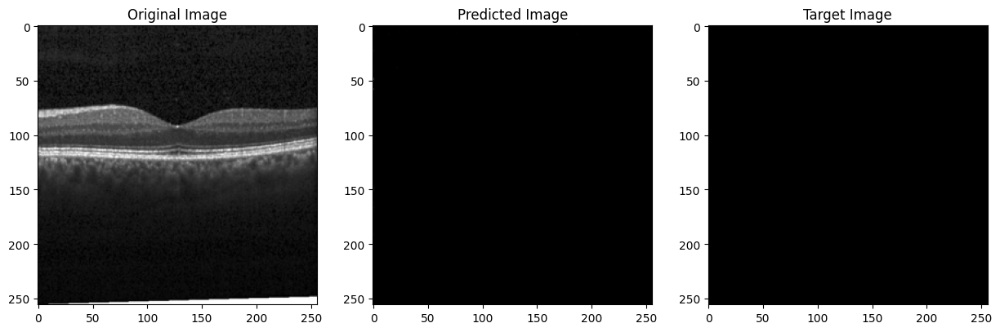

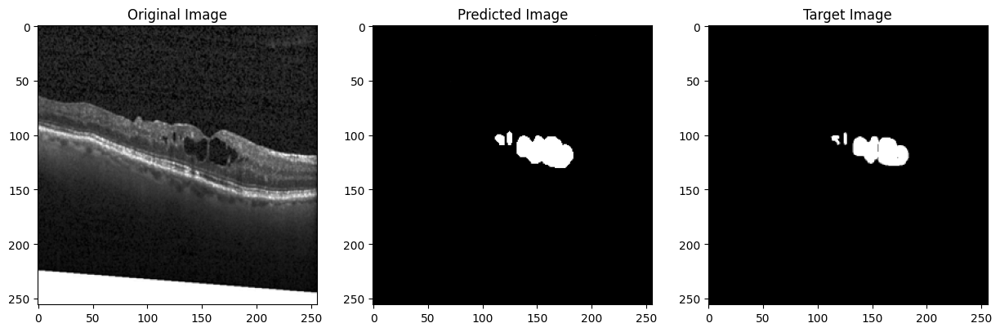

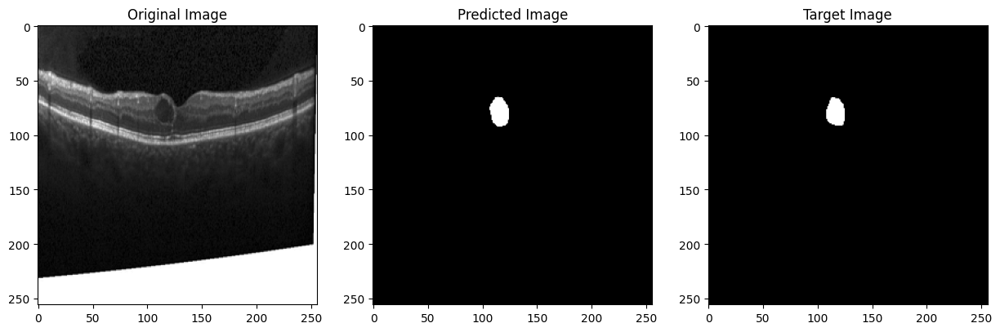

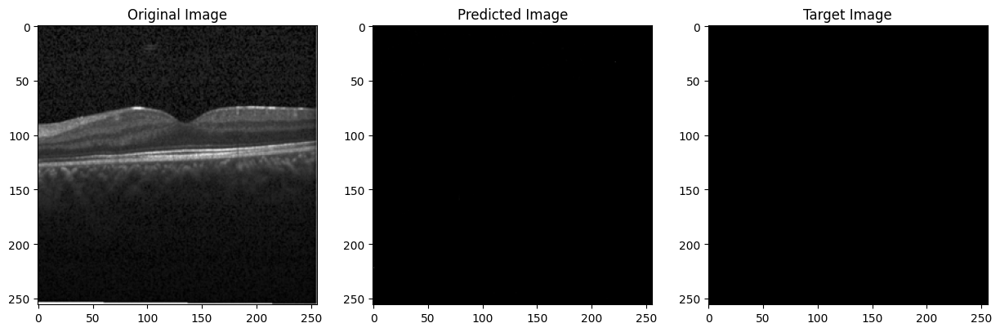

...

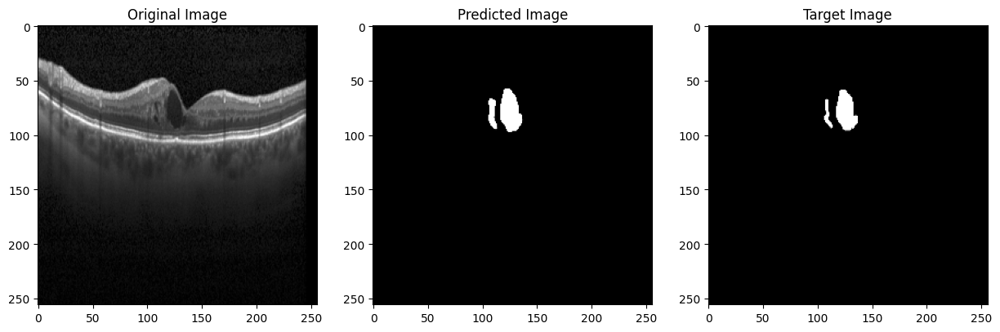

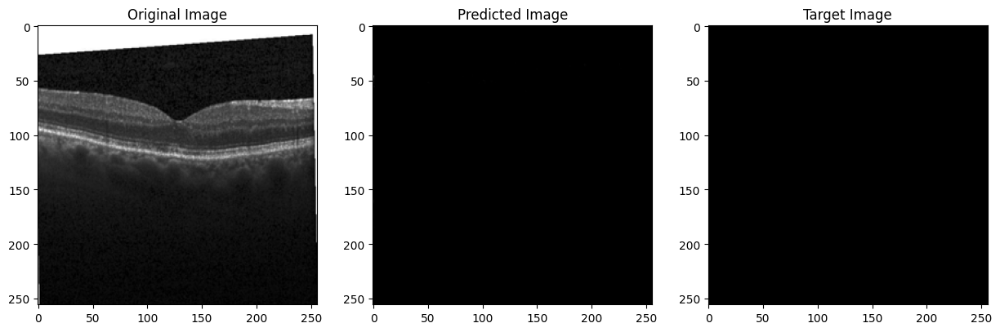

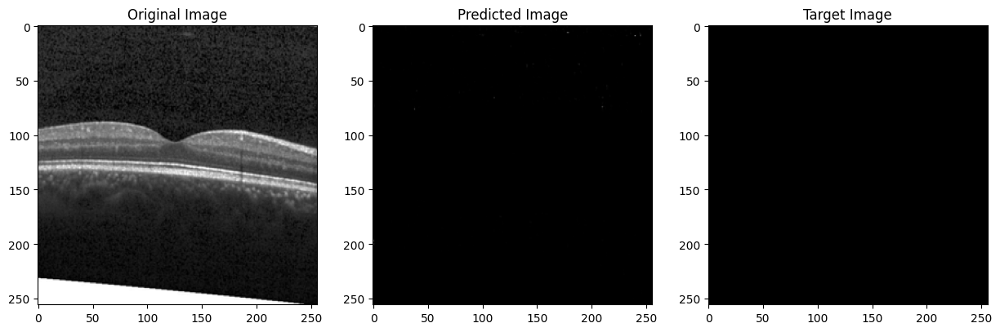

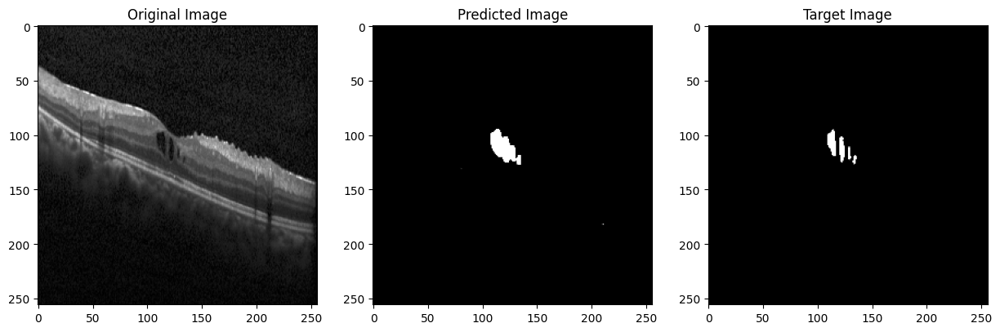

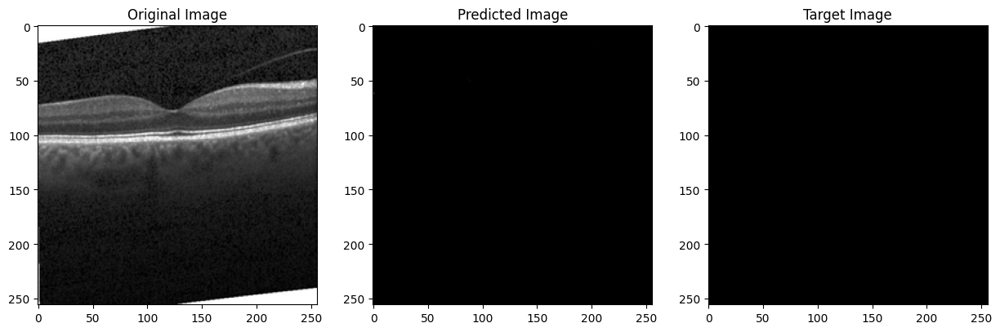

In [ ]:
num_samples = len(x_test)

for i in range(num_samples):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(x_test[i].squeeze(), cmap='gray')
    plt.title('Original Image')

    plt.subplot(1, 3, 2)
    plt.imshow(y_pred[i].squeeze(), cmap='gray')
    plt.title('Predicted Image')

    plt.subplot(1, 3, 3)
    plt.imshow(y_test[i], cmap='gray')
    plt.title('Target Image')

    plt.show()

## Evaluation

## Evaluation Metrics

### Model 01: FCNN

In [ ]:
train_acc = history.history['accuracy'][-1]
print(f'Training Accuracy at the end: {train_acc}')

Training Accuracy at the end: 0.9823071956634521


In [ ]:
test_loss, test_acc = model.evaluate(x_test, y_test)
print(f'Test accuracy: {test_acc}')

3/3 [==============================] - 1s 183ms/step - loss: -17.6811 - accuracy: 0.9788
Test accuracy: 0.9788479208946228


In [ ]:
y_pred = model.predict(x_test)

3/3 [==============================] - 1s 343ms/step


In [ ]:
threshold = 0.5
binary_predictions = (y_pred > threshold).astype(np.uint8)

ground_truth_flat = y_test.flatten()
predictions_flat = binary_predictions.flatten()

ground_truth_binary = (ground_truth_flat > 0.5).astype(int)
predictions_binary = (predictions_flat > threshold).astype(int)

conf_matrix = confusion_matrix(ground_truth_binary, predictions_binary)

true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]

iou = true_positive / (true_positive + false_positive + false_negative)
dice_coefficient = 2 * true_positive / (2 * true_positive + false_positive + false_negative)

precision = true_positive / (true_positive + false_positive)
recall = true_positive / (true_positive + false_negative)
f1_score = 2 * (precision * recall) / (precision + recall)

ground_truth_binary = (ground_truth_flat > 0.5).astype(int)
predictions_binary = (predictions_flat > threshold).astype(int)

conf_matrix = confusion_matrix(ground_truth_binary, predictions_binary)

true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]

pixel_accuracy = (true_positive + conf_matrix[0, 0]) / np.sum(conf_matrix)


In [ ]:
print(f'IoU: {iou:.4f}')
print(f'Dice Coefficient: {dice_coefficient:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1_score:.4f}')
print("Pixel Accuracy:", pixel_accuracy)

IoU: 0.6544
Dice Coefficient: 0.7911
Precision: 0.6599
Recall: 0.9874
F1 Score: 0.7911
Pixel Accuracy: 0.9934189070516558


In [ ]:
history = model.fit(x_test, y_test, epochs=350, batch_size=16)

history_dict = history.history
test_accuracy = history_dict['accuracy']
test_loss = history_dict['loss']

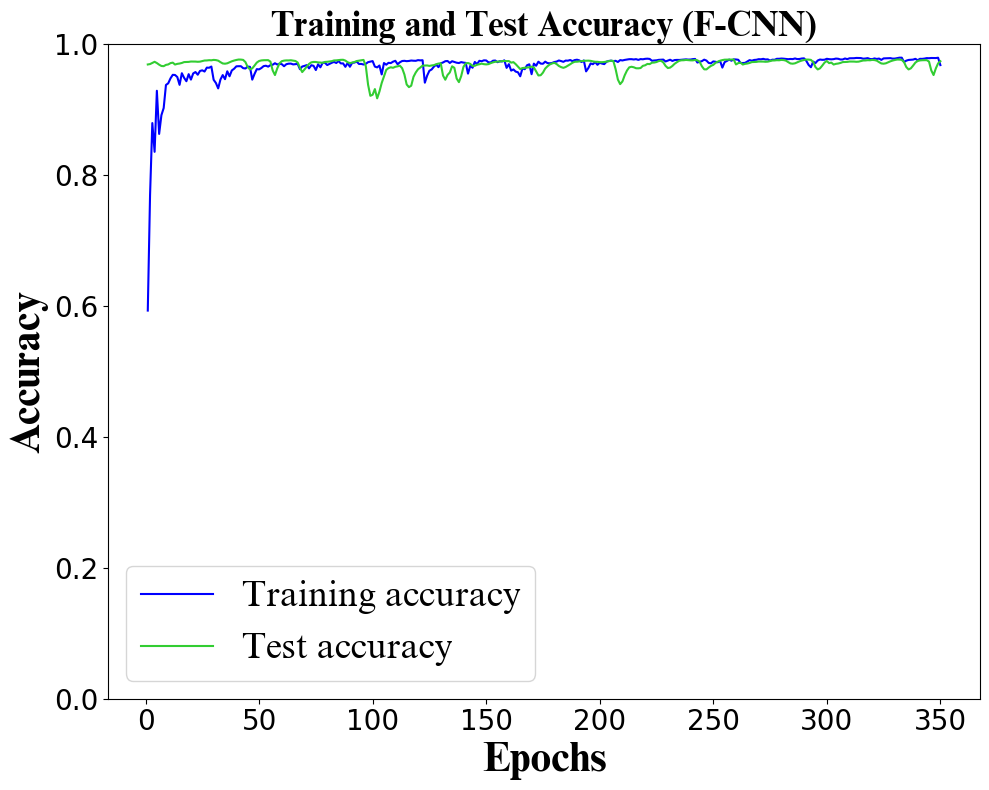

In [ ]:
font_path = '/content/times new roman.ttf'
prop = FontProperties(fname=font_path)
prop.set_size(26)
prop_b = FontProperties(fname='/content/times new roman bold.ttf')

epochs = range(1, len(train_accuracy) + 1)


plt.figure(figsize=(10, 8))
plt.plot(epochs, train_accuracy, 'b', label='Training accuracy')
plt.plot(epochs, test_accuracy, 'limegreen', label='Test accuracy')
plt.title('Training and Test Accuracy (F-CNN)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Accuracy', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.ylim(0, 1)
plt.tight_layout()
plt.show()


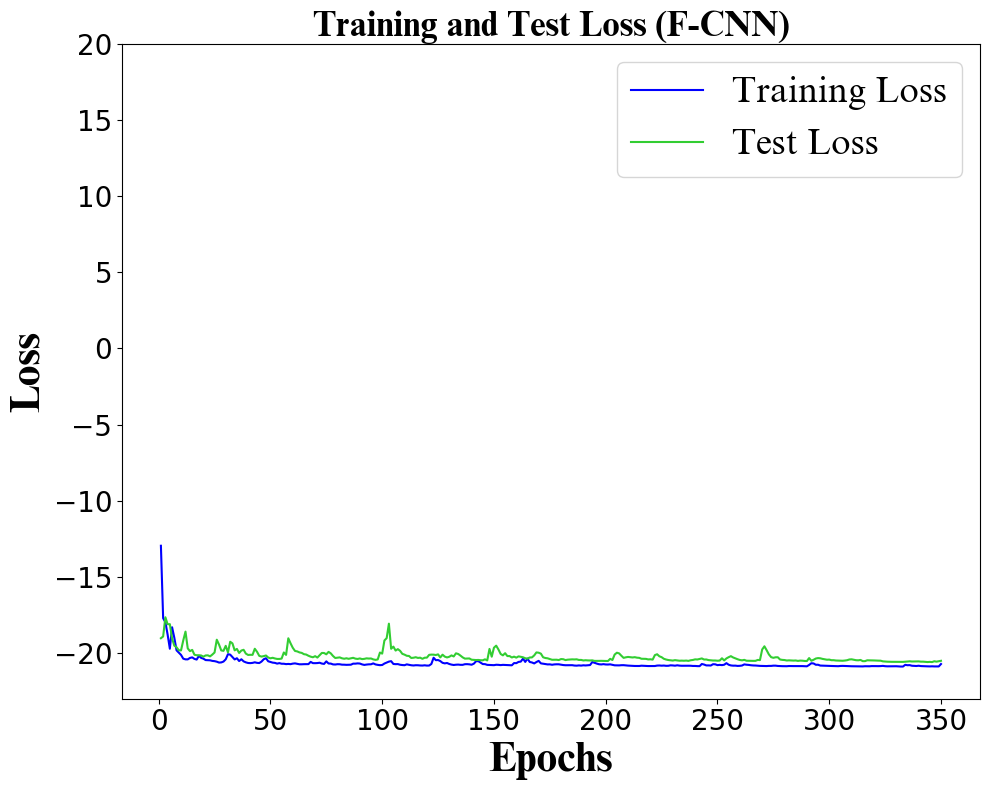

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, test_loss, 'limegreen', label='Test Loss')
plt.title('Training and Test Loss (F-CNN)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Loss', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.ylim(-23, 20)
plt.tight_layout()
plt.show()

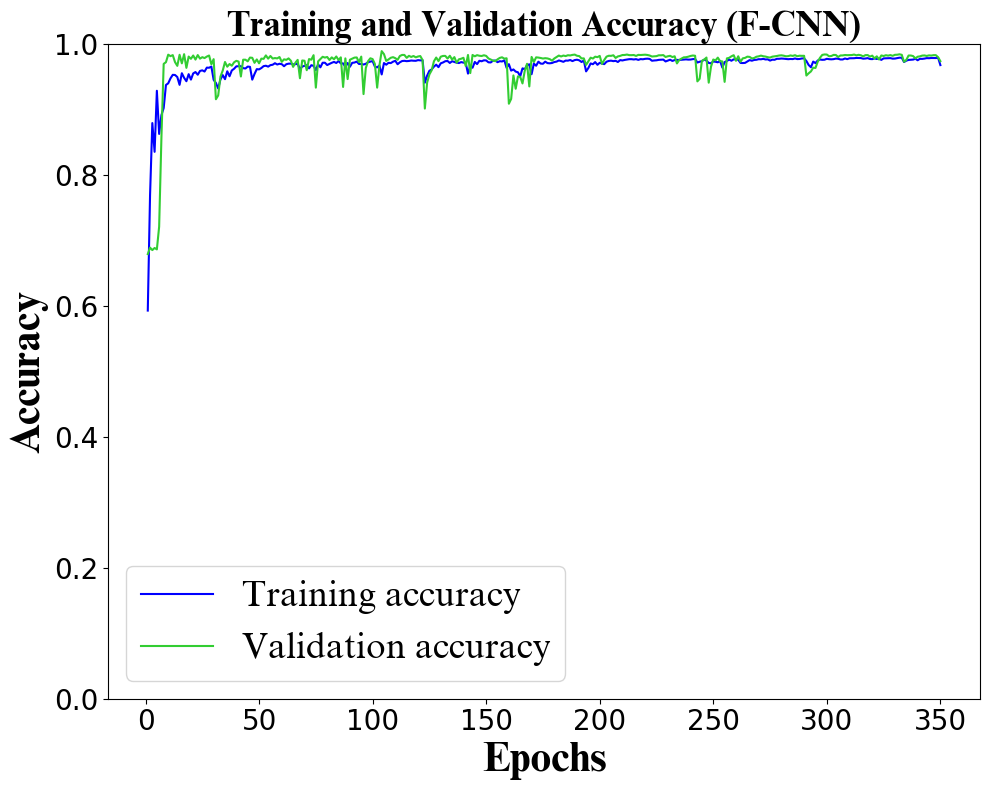

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_accuracy, 'b', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'limegreen', label='Validation accuracy')
plt.title('Training and Validation Accuracy (F-CNN)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Accuracy', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.ylim(0,1)
plt.tight_layout()
plt.show()

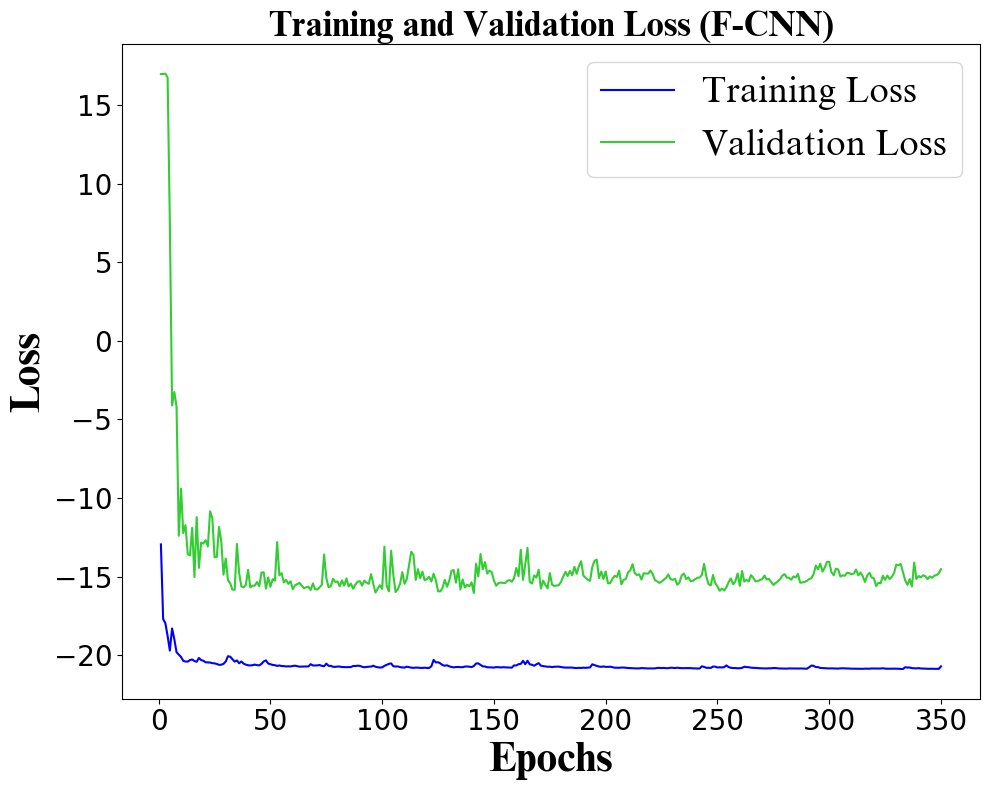

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'limegreen', label='Validation Loss')
plt.title('Training and Validation Loss (F-CNN)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Loss', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)

plt.tight_layout()
plt.show()

### Model 02: SEGNET

In [ ]:
train_acc = history.history['accuracy'][-1]
print(f'Training Accuracy at the end: {train_acc}')

Training Accuracy at the end: 0.9801177978515625


In [ ]:
test_loss, test_acc = model.evaluate(x_test, y_test)
print(f'Test accuracy: {test_acc}')

3/3 [==============================] - 1s 219ms/step - loss: -22.1105 - accuracy: 0.9791
Test accuracy: 0.9790984392166138


In [ ]:
y_pred = model.predict(x_test)

3/3 [==============================] - 1s 408ms/step


In [ ]:
threshold = 0.5
binary_predictions = (y_pred > threshold).astype(np.uint8)

ground_truth_flat = y_test.flatten()
predictions_flat = binary_predictions.flatten()

ground_truth_binary = (ground_truth_flat > 0.5).astype(int)
predictions_binary = (predictions_flat > threshold).astype(int)

conf_matrix = confusion_matrix(ground_truth_binary, predictions_binary)

true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]

iou = true_positive / (true_positive + false_positive + false_negative)
dice_coefficient = 2 * true_positive / (2 * true_positive + false_positive + false_negative)

precision = true_positive / (true_positive + false_positive)
recall = true_positive / (true_positive + false_negative)
f1_score = 2 * (precision * recall) / (precision + recall)

ground_truth_binary = (ground_truth_flat > 0.5).astype(int)
predictions_binary = (predictions_flat > threshold).astype(int)

conf_matrix = confusion_matrix(ground_truth_binary, predictions_binary)

true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]

pixel_accuracy = (true_positive + conf_matrix[0, 0]) / np.sum(conf_matrix)


In [ ]:
print(f'IoU: {iou:.4f}')
print(f'Dice Coefficient: {dice_coefficient:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1_score:.4f}')
print("Pixel Accuracy:", pixel_accuracy)

IoU: 0.7078
Dice Coefficient: 0.8289
Precision: 0.7205
Recall: 0.9758
F1 Score: 0.8289
Pixel Accuracy: 0.9938926127419543


In [ ]:
history = model.fit(x_test, y_test, epochs=350, batch_size=16)

history_dict = history.history
test_accuracy = history_dict['accuracy']
test_loss = history_dict['loss']

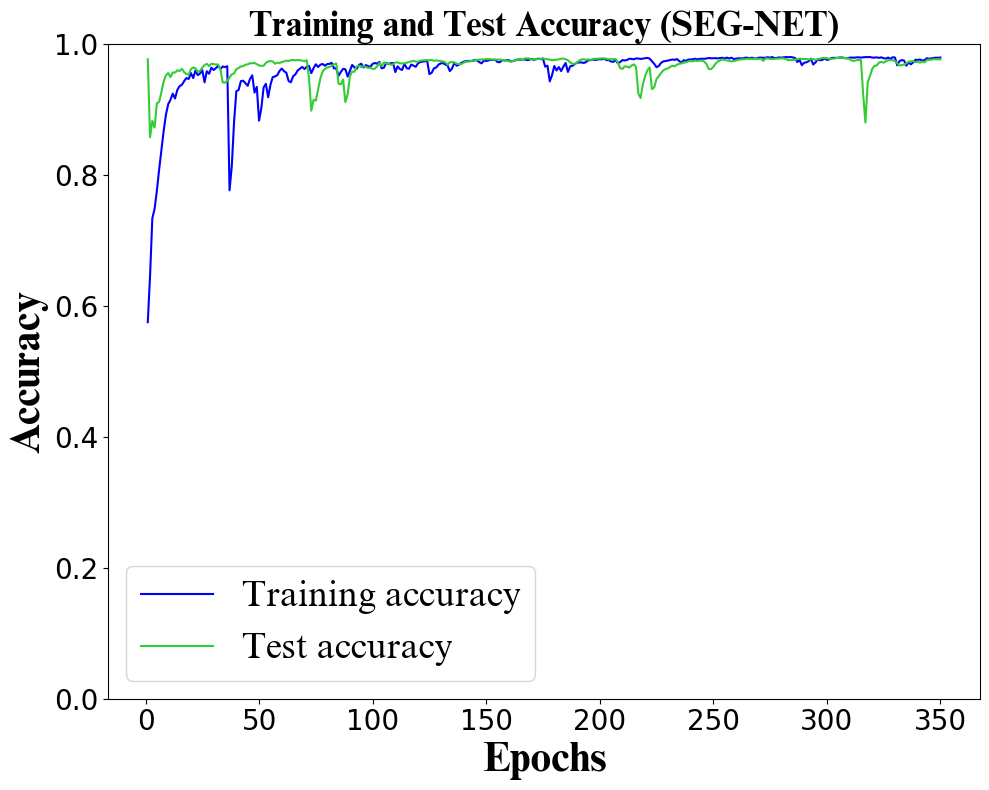

In [ ]:
font_path = '/content/times new roman.ttf'
prop = FontProperties(fname=font_path)
prop.set_size(26)
prop_b = FontProperties(fname='/content/times new roman bold.ttf')


epochs = range(1, len(train_accuracy) + 1)


plt.figure(figsize=(10, 8))
plt.plot(epochs, train_accuracy, 'b', label='Training accuracy')
plt.plot(epochs, test_accuracy, 'limegreen', label='Test accuracy')
plt.title('Training and Test Accuracy (SEG-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Accuracy', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

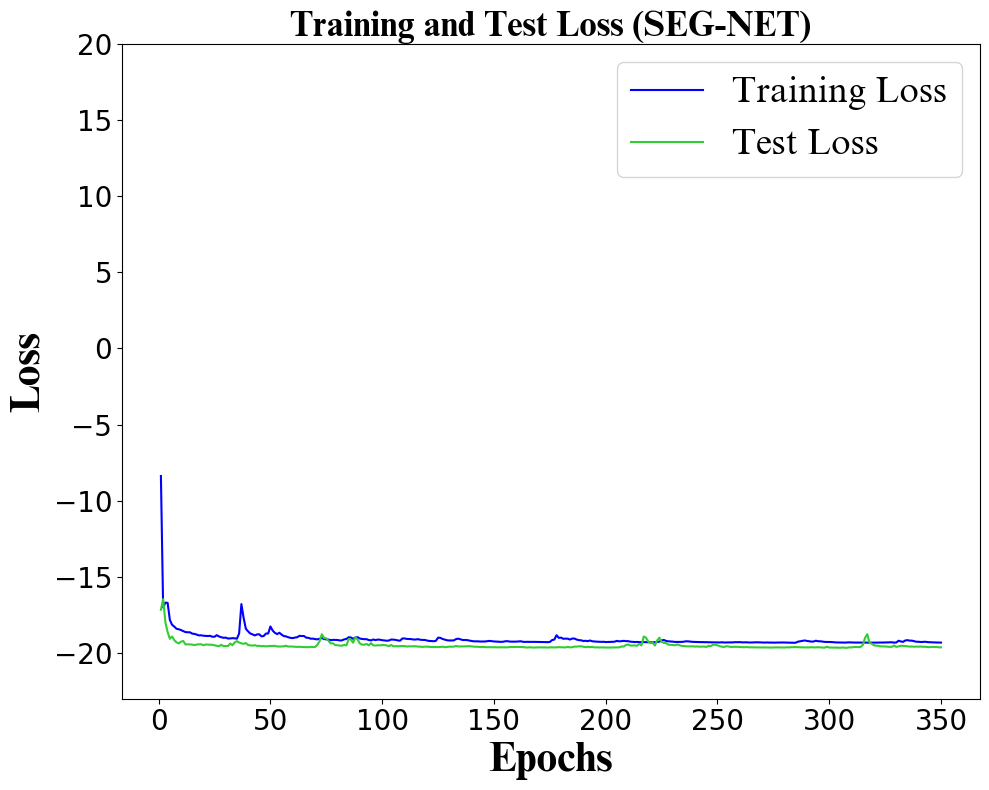

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, test_loss, 'limegreen', label='Test Loss')
plt.title('Training and Test Loss (SEG-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Loss', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.ylim(-23, 20)
plt.tight_layout()
plt.show()

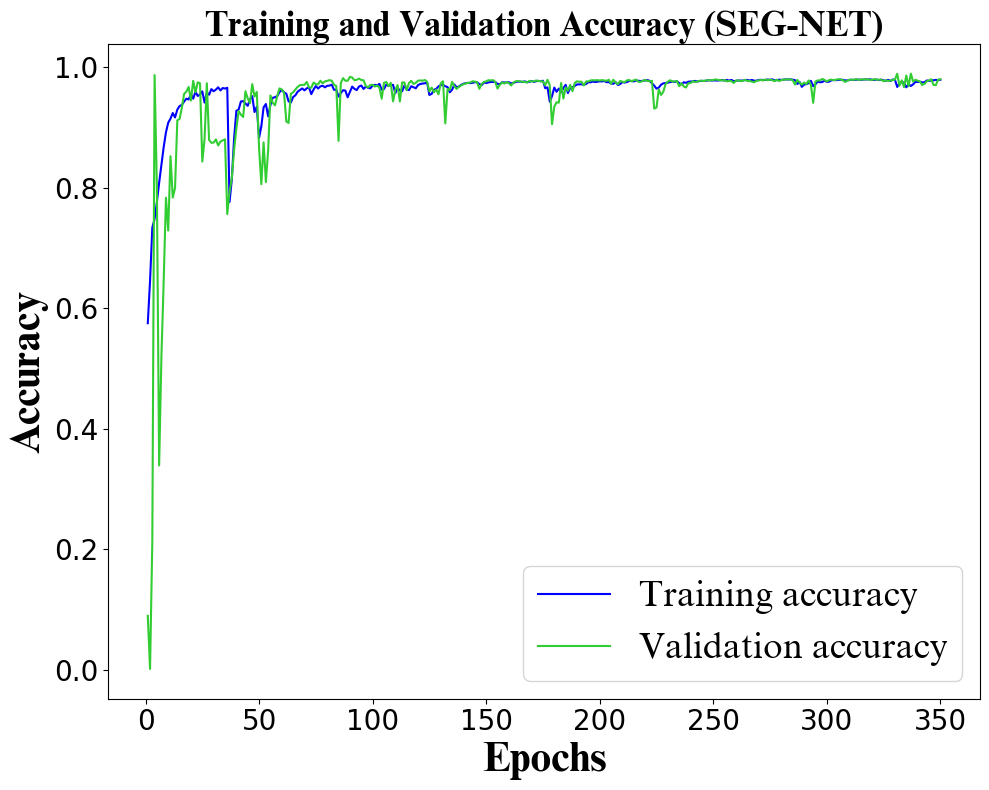

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_accuracy, 'b', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'limegreen', label='Validation accuracy')
plt.title('Training and Validation Accuracy (SEG-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Accuracy', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)

plt.tight_layout()
plt.show()

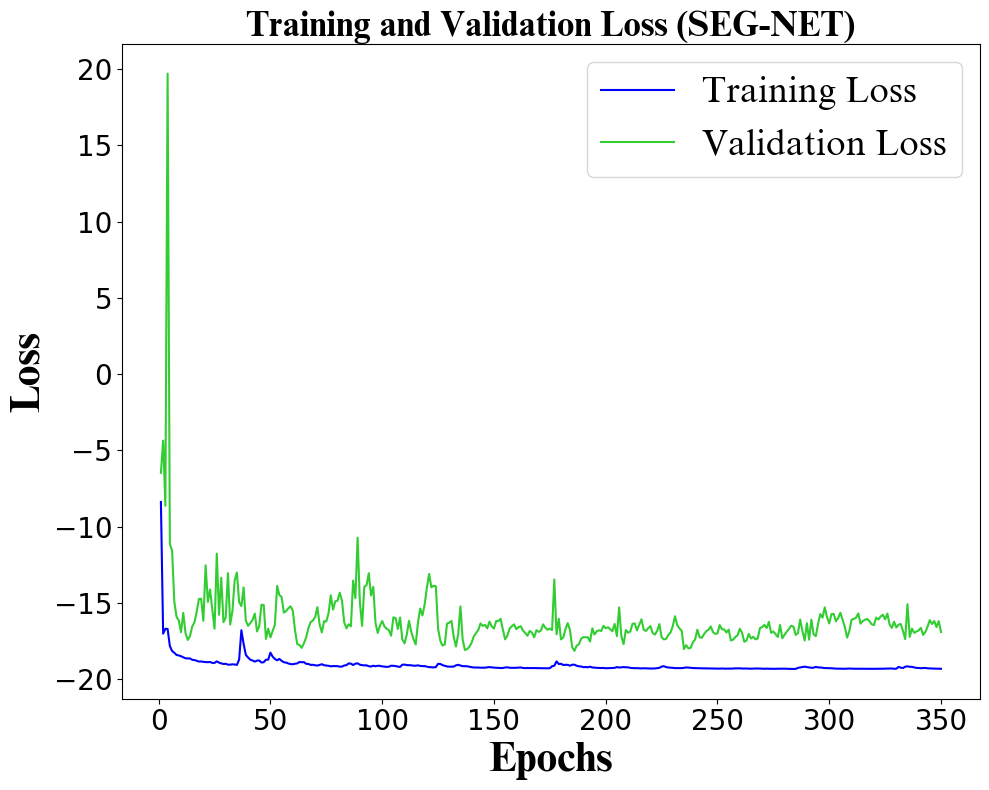

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'limegreen', label='Validation Loss')
plt.title('Training and Validation Loss (SEG-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Loss', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)

plt.tight_layout()
plt.show()

### Model 03: U-NET

In [ ]:
train_acc = history.history['accuracy'][-1]
print(f'Training Accuracy at the end: {train_acc}')

Training Accuracy at the end: 0.9832829833030701


In [ ]:
test_loss, test_acc = model.evaluate(x_test, y_test)
print(f'Test accuracy: {test_acc}')

3/3 [==============================] - 1s 275ms/step - loss: -17.0201 - accuracy: 0.9856
Test accuracy: 0.9856430888175964


In [ ]:
y_pred = model.predict(x_test)

3/3 [==============================] - 123s 26s/step


In [ ]:
threshold = 0.5
binary_predictions = (y_pred > threshold).astype(np.uint8)

ground_truth_flat = y_test.flatten()
predictions_flat = binary_predictions.flatten()

ground_truth_binary = (ground_truth_flat > 0.5).astype(int)
predictions_binary = (predictions_flat > threshold).astype(int)

conf_matrix = confusion_matrix(ground_truth_binary, predictions_binary)

true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]

iou = true_positive / (true_positive + false_positive + false_negative)
dice_coefficient = 2 * true_positive / (2 * true_positive + false_positive + false_negative)

precision = true_positive / (true_positive + false_positive)
recall = true_positive / (true_positive + false_negative)
f1_score = 2 * (precision * recall) / (precision + recall)

ground_truth_binary = (ground_truth_flat > 0.5).astype(int)
predictions_binary = (predictions_flat > threshold).astype(int)

conf_matrix = confusion_matrix(ground_truth_binary, predictions_binary)

true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]

pixel_accuracy = (true_positive + conf_matrix[0, 0]) / np.sum(conf_matrix)


In [ ]:
print(f'IoU: {iou:.4f}')
print(f'Dice Coefficient: {dice_coefficient:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1_score:.4f}')
print("Pixel Accuracy:", pixel_accuracy)

IoU: 0.7938
Dice Coefficient: 0.8850
Precision: 0.8038
Recall: 0.9845
F1 Score: 0.8850
Pixel Accuracy: 0.997039111692514


In [ ]:
history = model.fit(x_test, y_test, epochs=350, batch_size=16)

history_dict = history.history
test_accuracy = history_dict['accuracy']
test_loss = history_dict['loss']

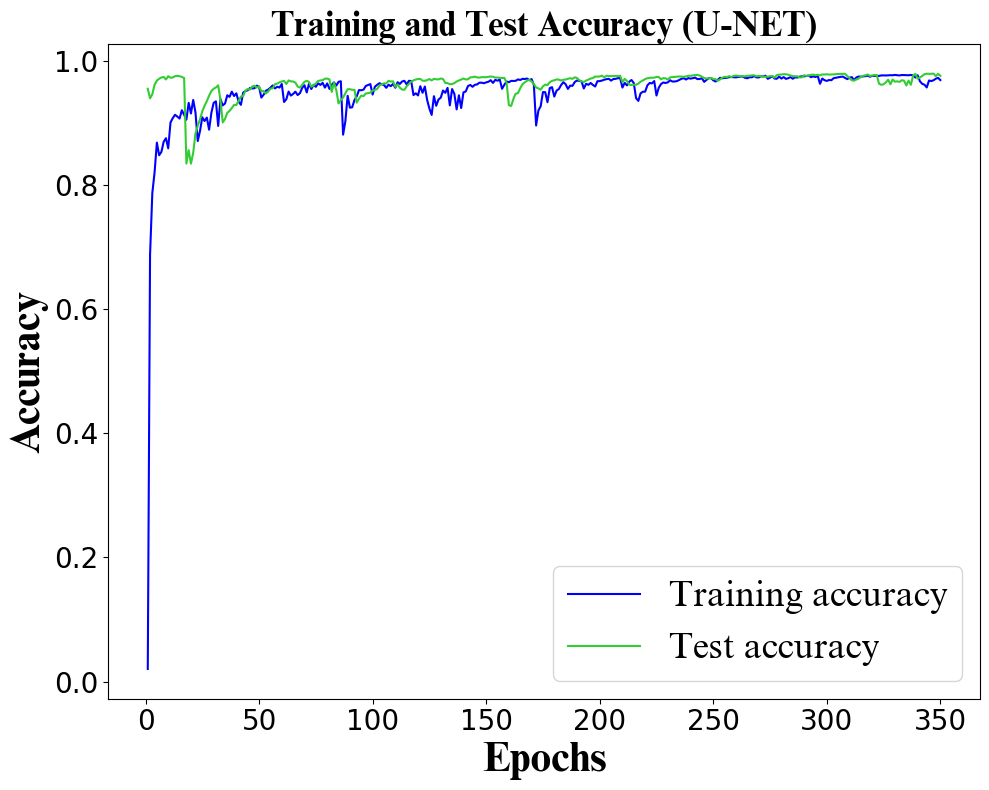

In [ ]:
font_path = '/content/times new roman.ttf'
prop = FontProperties(fname=font_path)
prop.set_size(26)
prop_b = FontProperties(fname='/content/times new roman bold.ttf')

epochs = range(1, len(train_accuracy) + 1)

plt.figure(figsize=(10, 8))
plt.plot(epochs, train_accuracy, 'b', label='Training accuracy')
plt.plot(epochs, test_accuracy, 'limegreen', label='Test accuracy')
plt.title('Training and Test Accuracy (U-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Accuracy', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.tight_layout()
plt.show()


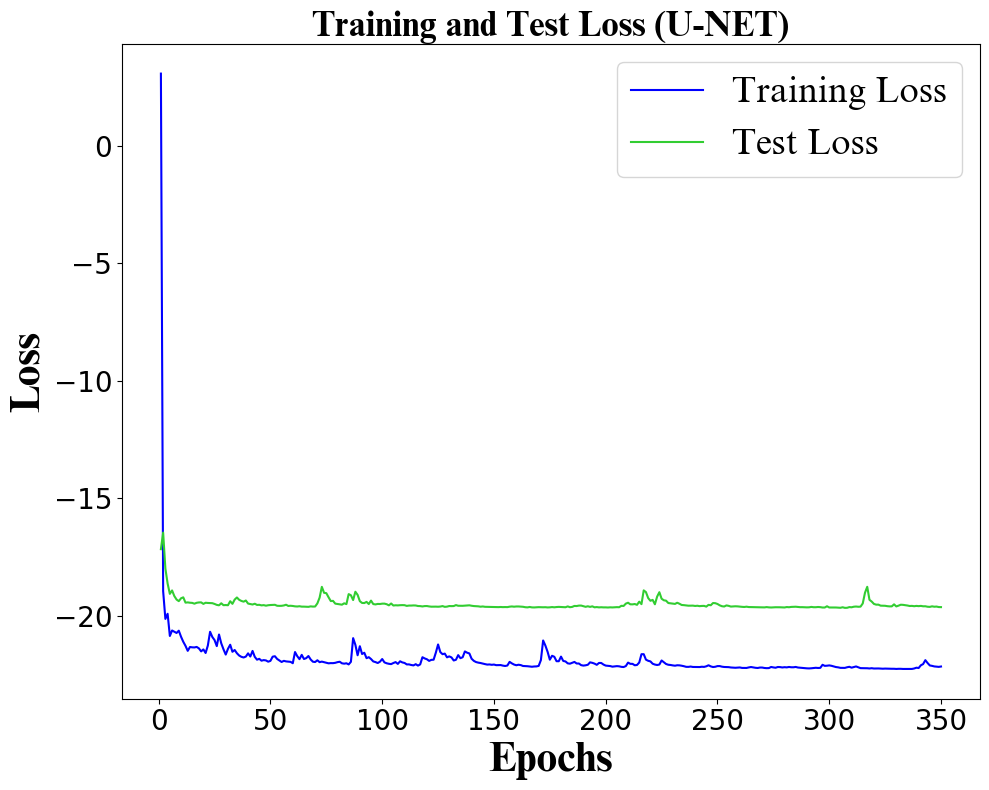

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, test_loss, 'limegreen', label='Test Loss')
plt.title('Training and Test Loss (U-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Loss', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.tight_layout()
plt.show()

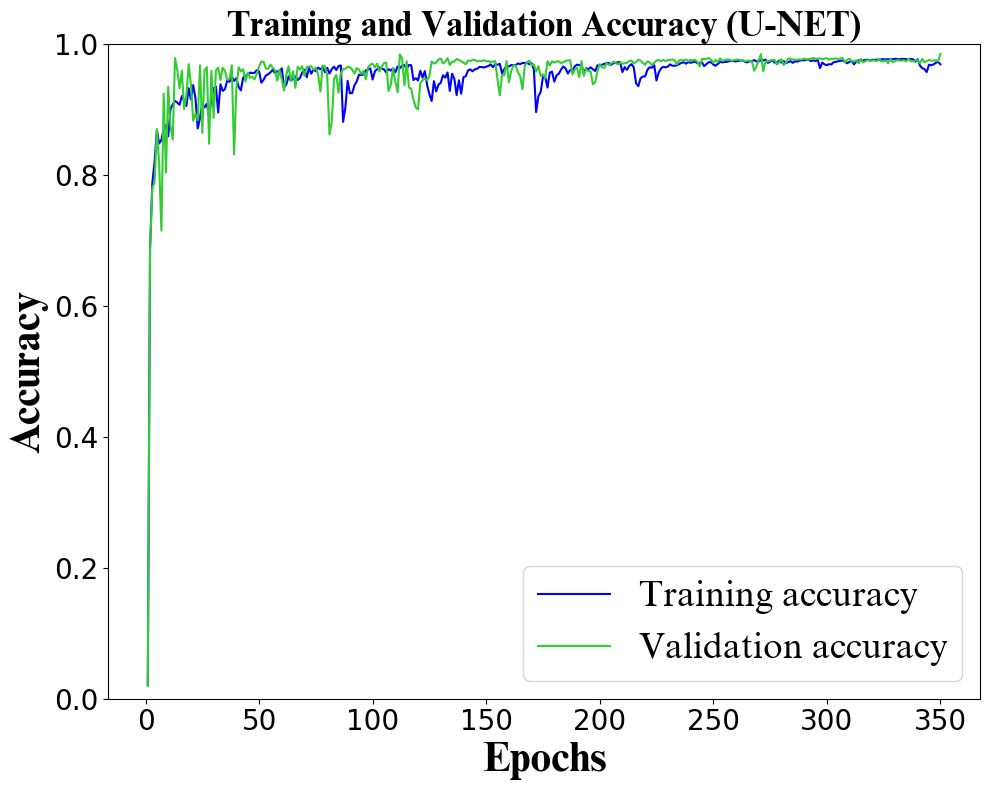

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_accuracy, 'b', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'limegreen', label='Validation accuracy')
plt.title('Training and Validation Accuracy (U-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Accuracy', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)
plt.ylim(0,1)
plt.tight_layout()
plt.show()

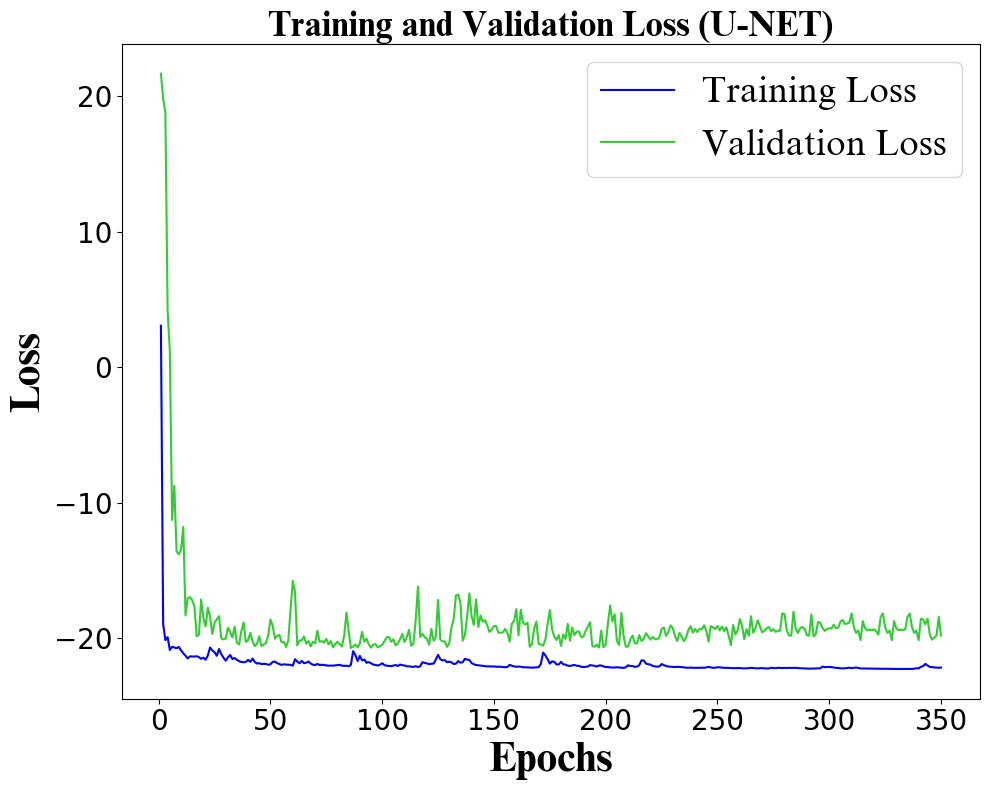

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'limegreen', label='Validation Loss')
plt.title('Training and Validation Loss (U-NET)', fontproperties=prop_b, fontsize=25, fontweight='bold')
plt.xlabel('Epochs', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.ylabel('Loss', fontproperties=prop_b, fontsize=30, fontweight='bold')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(prop=prop, fontsize=20)

plt.tight_layout()
plt.show()

## Comparision Of Metrics

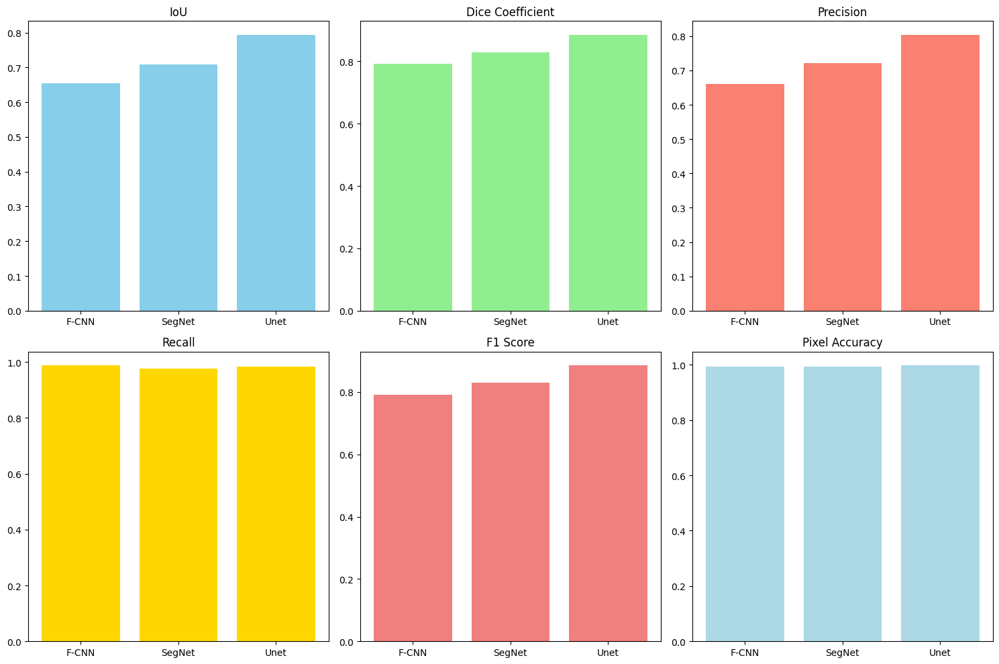

In [ ]:
models = ['F-CNN', 'SegNet', 'Unet']
IoU = [0.6544, 0.7078, 0.7938]
Dice_Coefficient = [0.7911, 0.8289, 0.8850]
Precision = [0.6599, 0.7205, 0.8038]
Recall = [0.9874, 0.9758, 0.9845]
F1_Score = [0.7911, 0.8289,0.8850]
Pixel_Accuracy = [0.9934189070516558, 0.9938926127419543, 0.997039111692514]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

axs[0, 0].bar(models, IoU, color='skyblue')
axs[0, 0].set_title('IoU')

axs[0, 1].bar(models, Dice_Coefficient, color='lightgreen')
axs[0, 1].set_title('Dice Coefficient')

axs[0, 2].bar(models, Precision, color='salmon')
axs[0, 2].set_title('Precision')

axs[1, 0].bar(models, Recall, color='gold')
axs[1, 0].set_title('Recall')

axs[1, 1].bar(models, F1_Score, color='lightcoral')
axs[1, 1].set_title('F1 Score')

axs[1, 2].bar(models, Pixel_Accuracy, color='lightblue')
axs[1, 2].set_title('Pixel Accuracy')

plt.tight_layout()

plt.show()


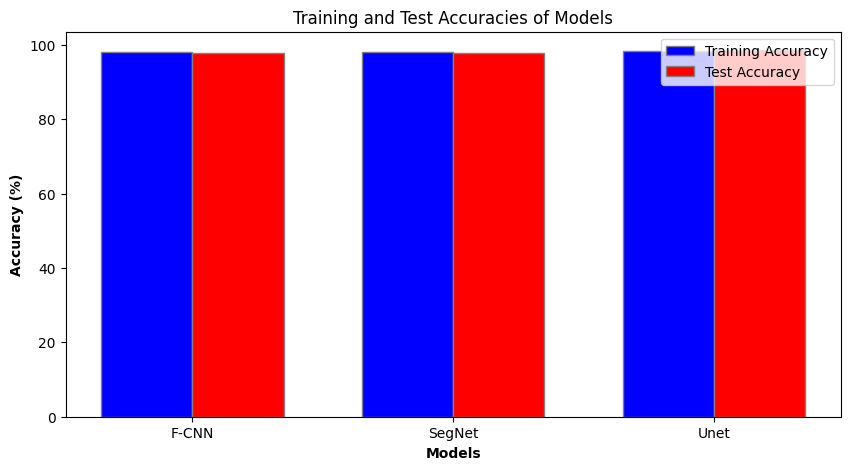

In [ ]:
models = ['F-CNN', 'SegNet', 'Unet']

training_accuracies = [98.2, 98.1, 98.3]

test_accuracies = [97.8, 97.9, 98.6]

bar_width = 0.35

r1 = np.arange(len(models))
r2 = [x + bar_width for x in r1]

plt.figure(figsize=(10, 5))

plt.bar(r1, training_accuracies, color='b', width=bar_width, edgecolor='grey', label='Training Accuracy')

plt.bar(r2, test_accuracies, color='r', width=bar_width, edgecolor='grey', label='Test Accuracy')

plt.xlabel('Models', fontweight='bold')
plt.ylabel('Accuracy (%)', fontweight='bold')
plt.xticks([r + bar_width / 2 for r in range(len(models))], models)

plt.legend()

plt.title('Training and Test Accuracies of Models')
plt.show()


### Merged Prediction

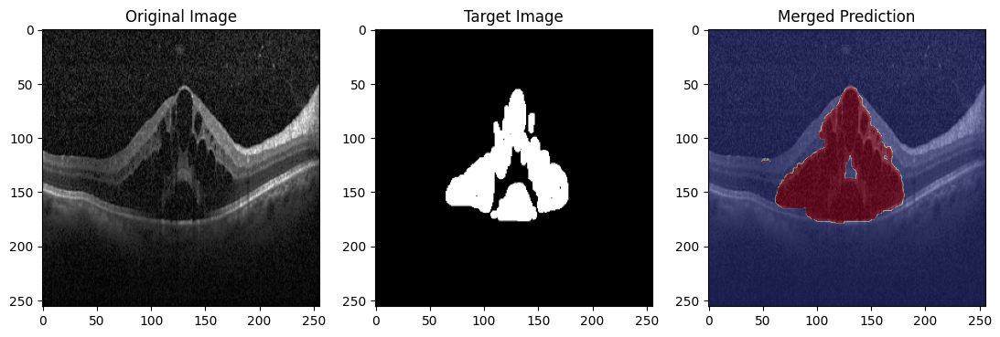

In [ ]:
index_to_visualize =16

plt.figure(figsize=(18, 5))

plt.subplot(1, 4, 1)
plt.imshow(x_test[index_to_visualize].squeeze(), cmap='gray')
plt.title('Original Image')


plt.subplot(1, 4, 2)
plt.imshow(y_test[index_to_visualize], cmap='gray')
plt.title('Target Image')

plt.subplot(1, 4, 3)
merged_image = x_test[index_to_visualize].squeeze()
alpha = 0.5
plt.imshow(merged_image, cmap='gray')
plt.imshow(y_pred[index_to_visualize].squeeze(), cmap='RdYlBu_r', alpha=alpha)
plt.title('Merged Prediction')

plt.show()

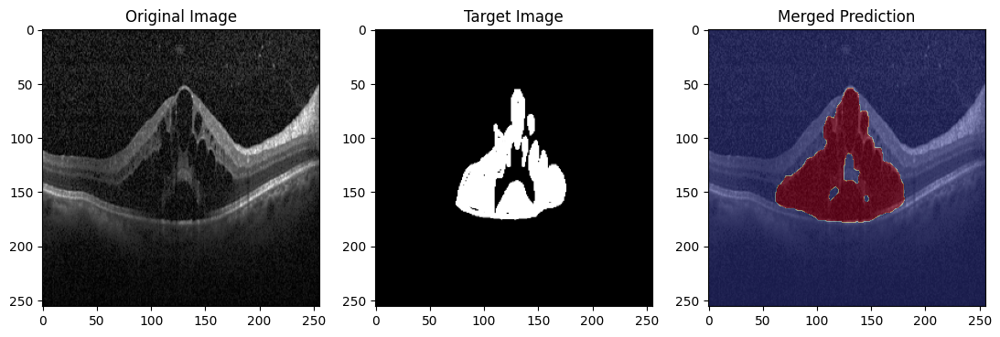

In [ ]:
index_to_visualize =37

plt.figure(figsize=(18, 5))

plt.subplot(1, 4, 1)
plt.imshow(x_test[index_to_visualize].squeeze(), cmap='gray')
plt.title('Original Image')


plt.subplot(1, 4, 2)
plt.imshow(y_test[index_to_visualize], cmap='gray')
plt.title('Target Image')

plt.subplot(1, 4, 3)
merged_image = x_test[index_to_visualize].squeeze()
alpha = 0.5
plt.imshow(merged_image, cmap='gray')
plt.imshow(y_pred[index_to_visualize].squeeze(), cmap='RdYlBu_r', alpha=alpha)
plt.title('Merged Prediction')

plt.show()

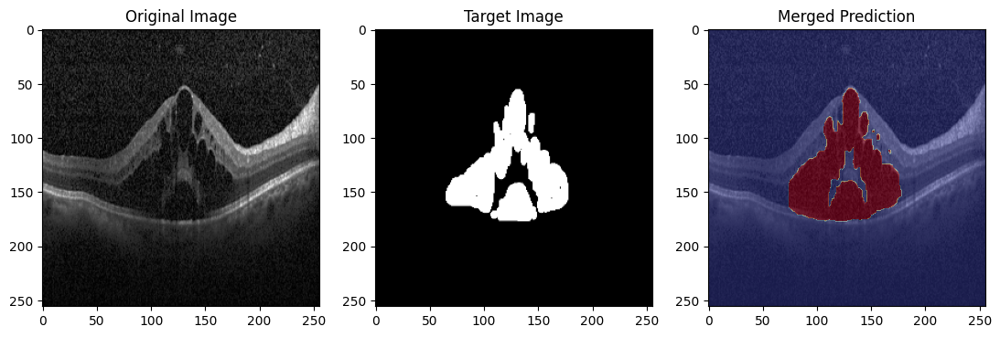

In [ ]:
index_to_visualize = 6

plt.figure(figsize=(18, 5))

plt.subplot(1, 4, 1)
plt.imshow(x_test[index_to_visualize].squeeze(), cmap='gray')
plt.title('Original Image')


plt.subplot(1, 4, 2)
plt.imshow(y_test[index_to_visualize], cmap='gray')
plt.title('Target Image')

plt.subplot(1, 4, 3)
merged_image = x_test[index_to_visualize].squeeze()
alpha = 0.5
plt.imshow(merged_image, cmap='gray')
plt.imshow(y_pred[index_to_visualize].squeeze(), cmap='RdYlBu_r', alpha=alpha)
plt.title('Merged Prediction')

plt.show()